In [1]:
import os
import sys
#sys.path.append('C:\\Users\\dhruv\\Anaconda3\\envs\\testPanorama\\Lib\\site-packages')
import cv2
import numpy as np
import matplotlib.pyplot as plt
import imageio
import imutils
from imutils import paths
from sklearn.datasets import make_classification
from sklearn.cluster import MeanShift
from matplotlib import pyplot
import random
import pickle
import csv
from pandas import *
import math

In [2]:
!export PATH=/Library/TeX/texbin:$PATH

'export' is not recognized as an internal or external command,
operable program or batch file.


## Data Loader for CSV Logs and Mapping Input to 4 window coords 

In [3]:
## Loading Coords from CSV File & Mapping to all 4 coords of Windows logic

def loadCoordsFromCSV(filePath):
    with open(filePath, newline='') as f:
        csvread = csv.reader(f)
        batch_data = list(csvread)

    batch_data_int = []
    for inner_list in batch_data:
        innet_out_list = []
        for string in inner_list:
            if string == 'nan':
                string = np.nan
            innet_out_list.append((float(string)))
        batch_data_int.append(innet_out_list)

    FinalList = []
    for i in range(len(batch_data_int)):
        el = batch_data_int[i]
        elChunks = [el[x:x+4] for x in range(0, len(el), 4)]
        newElChunks = elChunks.copy()
        for i in range(len(elChunks)):
            chunk = elChunks[i]
            newChunk = chunk.copy()

            newChunk.insert(2, chunk[0])
            newChunk.insert(3, chunk[3])
            newChunk.insert(6, chunk[2])
            newChunk.insert(7, chunk[1])
            newElChunks[i] = newChunk
        perImageCoords = np.array(newElChunks)
        perImageCoords = perImageCoords.reshape(-1,4,2)
        FinalList.append(perImageCoords)

    print("Final list size:", len(FinalList))
    return FinalList


def mapToAll4Coords(input):
    '''
    Here, input is in form of list of sX, sY, eX, eY i.e. only top-left and bottom-right corner coordinates
    INPUT -
    input: [[[s1x_1,s1y_1,e1x_1,e1y_1], [s2x_1, s2y_1, e2x_1, e2y_1]],   [[s1x_2,s1y_2,e1x_2,e1y_2],[s2x_2,s2y_2,e2x_2,e2y_2]]]
    
    Here NOTE: 1st element i.e. [[s1x_1,s1y_1, e1x_1,e1y_1], [s2x_1, s2y_1, e2x_1, e2y_1]] corresponds to 1st image
    [s1x_1, s1y_1, e1x_1, e1y_1] -> 1st window in Image1
    [s2x_1, s2y_1, e2x_1, e2y_1] -> 2nd window in Image1
    '''
    inputInListOfLists = [arr.tolist() for arr in input]
    finalListMappedWithAll4Coords = []
    for image in inputInListOfLists:
        finalSubList = []
        imageClone = image.copy()
        for i in range(len(image)):
            window = image[i]
            windowClone = window.copy()
            windowClone.insert(2, window[0])
            windowClone.insert(3, window[3])
            windowClone.insert(6, window[2])
            windowClone.insert(7, window[1])
            imageClone[i] = windowClone
        perImageCoords = np.array(imageClone)
        perImageCoords = perImageCoords.reshape(-1,4,2)
        finalListMappedWithAll4Coords.append(perImageCoords)
    
    return finalListMappedWithAll4Coords

In [4]:
## Eg to test mapToAll4Coords()
input = [np.array([[107, 225, 255, 332]]), np.array([[100, 295, 255, 407]]), np.array([[125, 455, 275, 550], [92, 17, 255, 165]])]
input_Arr = np.array(input)
print('input_Arr: ', input_Arr)
mapped4Coords = mapToAll4Coords(input)
print('input_Arr after Mapping to 4 window coordinates: ', mapped4Coords)

input_Arr:  [array([[107, 225, 255, 332]]) array([[100, 295, 255, 407]])
 array([[125, 455, 275, 550],
        [ 92,  17, 255, 165]])]
input_Arr after Mapping to 4 window coordinates:  [array([[[107, 225],
        [107, 332],
        [255, 332],
        [255, 225]]]), array([[[100, 295],
        [100, 407],
        [255, 407],
        [255, 295]]]), array([[[125, 455],
        [125, 550],
        [275, 550],
        [275, 455]],

       [[ 92,  17],
        [ 92, 165],
        [255, 165],
        [255,  17]]])]


<ipython-input-4-e426afc8a4e2>:3: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  input_Arr = np.array(input)


## Utils

In [5]:
def calculateRange(coordinates, padding, imageShape):
    '''
    Adds some tolerance to top-left and bottom-right coordinates of window corner
    '''
    minX = maxX = coordinates[0][0]
    minY = maxY = coordinates[0][1]
    startX = startY = endX = endY = 0
    h,w,c = imageShape
    for i in range(len(coordinates)):
        if minX > coordinates[i][0]:
            minX = coordinates[i][0]
        if maxX < coordinates[i][0]:
            maxX = coordinates[i][0]

        if minY > coordinates[i][1]:
            minY = coordinates[i][1]
        if maxY < coordinates[i][1]:
            maxY = coordinates[i][1]
    
    if (minX - padding < 0):
        startX = 0
    else:
        startX = minX - padding
    if (minY - padding < 0):
        startY = 0
    else:
        startY = minY - padding
    if (maxX + padding >= w):
        endX = w - 1
    else:
        endX = maxX + padding
    if (maxY + padding >= h):
        endY = h - 1
    else:
        endY = maxY + padding
    return startX, endX, startY, endY

def prepareBinaryMask(img_gray, coordinates, padding = 5, imageShape = (720,960,3)):
    ret, binary_img = cv2.threshold(img_gray, 255, 255, cv2.THRESH_BINARY)
    for i in range(coordinates.shape[0]):
        startX, endX, startY, endY = calculateRange(coordinates[i], padding, imageShape)
        binary_img[startY:endY, startX:endX] = 1
    return binary_img


def addPaddingToWindowCoords(coordinates, padding = 5, imageShape = (720,960,3)):
    '''
    Iterates over all coords and adds some padding. This is because the model inference might have tight bounding boxes.
    '''
    pick = []
    for i in range(coordinates.shape[0]):
        startX, endX, startY, endY = calculateRange(coordinates[i], padding, imageShape)
        pick.append([startX, startY, endX, endY])
    return pick


def plotBoxes(verticalPlane, boxes):
    for box in boxes:
        sX, sY, eX, eY = box
        cv2.rectangle(verticalPlane, (int(sX), int(sY)), (int(eX), int(eY)), (255, 255, 255), 3)
    
    fig, ax1 = plt.subplots(nrows=1, ncols=1, constrained_layout=False, figsize=(25, 500))
    ax1.imshow(verticalPlane, cmap="gray")
    ax1.set_xlabel("PLANE", fontsize=14)
    plt.show()
    cv2.imwrite('after_nms_vertical_plane.png',verticalPlane)

## Plane Mapping, NMS and Storey Logic Functions

In [6]:
# FOV = 82.6 degrees, imgDim = 720*960, FocalLength = 410 pixels
def mapToVerticalPlane(verticalPlane, img, boundingBoxes, focalLength, depth, height, y_correction, seq_num):
    '''
    It maps windows in an image on a vertical Plane.
    
    INPUT - 
    verticalPlane: dummy black plane where all windows would be visualized
    img: img in a sequence
    boundingBoxes:  all window coordinates of an img
    focalLength: focalLength(in pixels) of the UAV camera
    depth: depth(in cm) to the building
    height: Height of UAV(in cm)
    y_correction: Correcton in Y-axis due to orientation error
    seq_num: seq no. Is used to visualize all sequences parallely(with some distance approx. equal to w[width of image] between 2 sequences) on the vertical plane.
    '''
    mappedBoundingBoxes = []
    heightOfPlane = verticalPlane.shape[0]
    h, w, c = img.shape
    
    # Visualize each seq at a distance of w width
    seq_space = w
    
    for box in boundingBoxes:
        sX, sY, eX, eY = box
        print(box)
        
        sY = h/2 - sY
        eY = h/2 - eY
        
        mappedSX, mappedSY, mappedEX, mappedEY = sX + (seq_num - 1)*seq_space, int(heightOfPlane - ((sY*depth/focalLength) + y_correction + height)), eX + (seq_num - 1)*seq_space, int(heightOfPlane - ((eY*depth/focalLength) + y_correction + height))            
        
        cv2.rectangle(verticalPlane, (mappedSX, mappedSY), (mappedEX, mappedEY), (255, 255, 255), 4)
        
        mappedBoundingBoxes.append((mappedSX, mappedSY, mappedEX, mappedEY))
    return mappedBoundingBoxes
        
'''
def mapToVerticalPlane_v1(focalLength, depth, boundingBoxes, height, verticalPlane, img,
                          i, y_corrections, seq_num, orientation_allImages):
    mappedBoundingBoxes = []
    heightOfPlane = verticalPlane.shape[0]
    h, w, c = img.shape

    roll = orientation_allImages[0][i]
    pitch = orientation_allImages[1][i]
    yaw = orientation_allImages[2][i]

    RMatrix = to_rotm_zyx(np.radians(yaw), np.radians(pitch), np.radians(roll))
    
    for box in boundingBoxes:
        sX, sY, eX, eY = box
        print(box)
        
        sY = h/2 - sY
        eY = h/2 - eY
        
        print('Sx: ' + str(sX) + ' Sy: : ', str(sY))
        print('Ex: ' + str(eX) + ' Ey: ', str(eY))
        
        start = np.array([[sX],[sY],[0]])
        end = np.array([[eX],[eY],[0]])
        
        startRotated = np.matmul(RMatrix, start) # RMatrix*startMapped
        endRotated = np.matmul(RMatrix, end) # RMatrix*endMapped
        
        SXRotated = startRotated[0][0]
        SYRotated = startRotated[1][0]
        
        EXRotated = endRotated[0][0]
        EYRotated = endRotated[1][0]
        
        print('SxR: ' + str(SXRotated) + ' SyR: ', str(SYRotated))
        print('ExR: ' + str(EXRotated) + ' EyR: ', str(EYRotated))
        
        mappedSX, mappedSY, mappedEX, mappedEY = SXRotated, int(heightOfPlane - ((SYRotated*depth/focalLength) + height)), EXRotated, int(heightOfPlane - ((EYRotated*depth/focalLength) + height))
        cv2.rectangle(verticalPlane, (int(mappedSX), int(mappedSY)), (int(mappedEX), int(mappedEY)), (255, 255, 255), 4)
        
        mappedBoundingBoxes.append((mappedSX, mappedSY, mappedEX, mappedEY))
        
#         mappedSX, mappedSY, mappedEX, mappedEY = sX, int(heightOfPlane - ((sY*depth/focalLength) + height)), eX, int(heightOfPlane - ((eY*depth/focalLength) + height))
        
#         print('mappedSx: ' + str(mappedSX) + ' mappedSy: ', str(mappedSY))
#         print('mappedEx: ' + str(mappedEX) + ' mappedEy: ', str(mappedEY))
        
        
#         startMapped = np.array([[mappedSX],[mappedSY],[0]])
#         endMapped = np.array([[mappedEX],[mappedEY],[0]])
        
#         startMappedRotated = np.matmul(RMatrix, startMapped) # RMatrix*startMapped
#         endMappedRotated = np.matmul(RMatrix, endMapped) # RMatrix*endMapped
        
# #         print('startMappedRotated: ', startMappedRotated)
# #         print('endMappedRotated: ', endMappedRotated)
        
#         mappedSXRotated = startMappedRotated[0][0]
#         mappedSYRotated = startMappedRotated[1][0]
        
#         mappedEXRotated = endMappedRotated[0][0]
#         mappedEYRotated = endMappedRotated[1][0]
        
#         print('mappedSxR: ' + str(mappedSXRotated) + ' mappedSyR: ', str(mappedSYRotated))
#         print('mappedExR: ' + str(mappedEXRotated) + ' mappedEyR: ', str(mappedEYRotated))
        
#         cv2.rectangle(verticalPlane, (int(mappedSXRotated), int(mappedSYRotated)), (int(mappedEXRotated), int(mappedEYRotated)), (255, 255, 255), 4)
        
#         mappedBoundingBoxes.append((mappedSXRotated, mappedSYRotated, mappedEXRotated, mappedEYRotated))
    return mappedBoundingBoxes
'''
    

def non_max_suppression_fast(boxes, overlapThresh):
    '''
    NMS - Non-maxima suppression
    
    INPUT- 
    boxes: input window coordinates
    overlapThresh: Threshold for suppressing window bounding boxes 
    '''
    # if there are no boxes, return an empty list
    if len(boxes) == 0:
        return []
    # if the bounding boxes integers, convert them to floats --
    # this is important since we'll be doing a bunch of divisions
    if boxes.dtype.kind == "i":
        boxes = boxes.astype("float")
    # initialize the list of picked indexes	
    pick = []
    # grab the coordinates of the bounding boxes
    x1 = boxes[:,0]
    y1 = boxes[:,1]
    x2 = boxes[:,2]
    y2 = boxes[:,3]
    # compute the area of the bounding boxes and sort the bounding
    # boxes by the bottom-right y-coordinate of the bounding box
    area = (x2 - x1 + 1) * (y2 - y1 + 1)
    idxs = np.argsort(y2)
    # keep looping while some indexes still remain in the indexes
    # list
    while len(idxs) > 0:
        # grab the last index in the indexes list and add the
        # index value to the list of picked indexes
        last = len(idxs) - 1
        i = idxs[last]
        pick.append(i)
        # find the largest (x, y) coordinates for the start of
        # the bounding box and the smallest (x, y) coordinates
        # for the end of the bounding box
        xx1 = np.maximum(x1[i], x1[idxs[:last]])
        yy1 = np.maximum(y1[i], y1[idxs[:last]])
        xx2 = np.minimum(x2[i], x2[idxs[:last]])
        yy2 = np.minimum(y2[i], y2[idxs[:last]])
        # compute the width and height of the bounding box
        w = np.maximum(0, xx2 - xx1 + 1)
        h = np.maximum(0, yy2 - yy1 + 1)
        # compute the ratio of overlap
        overlap = (w * h) / area[idxs[:last]]
        # delete all indexes from the index list that have
        idxs = np.delete(idxs, np.concatenate(([last],
            np.where(overlap > overlapThresh)[0])))
    # return only the bounding boxes that were picked using the
    # integer data type
    return boxes[pick].astype("int")

############### Calculating storey #####################
def calculateStoreys(coords, heightOfPlane = 1500):
    '''
    Calculates storeys from coordinates of all detected windows
    '''
    yTop = coords[:,1]
    yBottom = coords[:,3]
    yAvg = (yTop + yBottom)/2
    storeyCount = 1 if len(coords) > 0 else 0
    index = 0
    storeyHeights = [heightOfPlane - yAvg[0]] if len(coords) > 0 else []
    '''
    print('yTop:', yTop)
    print('yAvg:', yAvg)
    print('yBottom:', yBottom)    
    '''
    print('yAvg Heights:', heightOfPlane - yAvg)

    singleStoreyHeight = []
    avgStoreyHeights = []
    
    for i in range(len(coords)):
        if (((yAvg[index] > yTop[i]) and (yAvg[index] < yBottom[i])) or 
            ((yTop[index] > yTop[i]) and (yTop[index] < yBottom[i]))  or
            ((yBottom[index] > yTop[i]) and (yBottom[index] < yBottom[i]))):
            singleStoreyHeight.append(heightOfPlane - yAvg[i])
            continue
        else:
            avgStoreyHeights.append(sum(singleStoreyHeight)/len(singleStoreyHeight))
            singleStoreyHeight = []
            index = i
            storeyCounted = False
            for j in range(i):  
                if (((yAvg[index] > yTop[j]) and (yAvg[index] < yBottom[j])) or 
                    ((yTop[index] > yTop[j]) and (yTop[index] < yBottom[j])) or
                    ((yBottom[index] > yTop[j]) and (yBottom[index] < yBottom[j]))):
                    storeyCounted = True
                    break
            if(storeyCounted == False):
                storeyHeights.append(heightOfPlane - yAvg[index])
                singleStoreyHeight.append(heightOfPlane - yAvg[i])
                storeyCount+=1
                
    avgStoreyHeights.append(sum(singleStoreyHeight)/len(singleStoreyHeight))
    print('avgStoreyHeights: ', avgStoreyHeights)
    print('StoreyCount after running post processing module: ', storeyCount)
    return storeyCount, storeyHeights, avgStoreyHeights

## IMU Functions

In [7]:

def readSeqLogs(seqLogFile):
    '''
    Reads Logs info(imageName, height info, orientation info[roll, pitch, yaw] etc) from a text file of a specific Sequences
    NOTE: The text file has a specific format. So you need to input logs in a specific format only.
    Sample logs file is provided in the same dir.
    '''
    data = read_csv(seqLogFile, sep = " , ", header=None) #read imu data file
    #print(data[1][0][1:-1].split(',')[9].split(':')[1])

    heights_allImages = [int(data[1][i][1:-1].split(',')[9].split(':')[1]) for i in range(len(data))]
    print(heights_allImages)

    imgNames = [(data[0][i].split(': ')[1]) for i in range(len(data))]
    print(imgNames)

    # in degrees
    pitch_allImages = [int(data[1][i][1:-1].split(',')[0].split(':')[1]) for i in range(len(data))]
    print('pitch: ', pitch_allImages)

    # in degrees read roll and yaw
    roll_allImages = [int(data[1][i][1:-1].split(',')[1].split(':')[1]) for i in range(len(data))]
    print('roll: ', roll_allImages)

    yaw_allImages = [int(data[1][i][1:-1].split(',')[2].split(':')[1]) for i in range(len(data))]
    print('yaw: ', yaw_allImages)

    #imu correction for pitch
    y_corrections = [-depth*np.tan(np.radians(int(pitch_allImages[i]))) for i in range(len(pitch_allImages))]
    print('y_corrections for pitch: ', y_corrections)
    print(len(y_corrections))
    
    orientation_allImages = [roll_allImages, pitch_allImages, yaw_allImages]
    return imgNames, heights_allImages, orientation_allImages, y_corrections

### Rotation matrix
def euler_to_rotMat(yaw, pitch, roll):
    Rz_yaw = np.array([
        [np.cos(yaw), -np.sin(yaw), 0],
        [np.sin(yaw),  np.cos(yaw), 0],
        [          0,            0, 1]])
    Ry_pitch = np.array([
        [ np.cos(pitch), 0, np.sin(pitch)],
        [             0, 1,             0],
        [-np.sin(pitch), 0, np.cos(pitch)]])
    Rx_roll = np.array([
        [1,            0,             0],
        [0, np.cos(roll), -np.sin(roll)],
        [0, np.sin(roll),  np.cos(roll)]])
    # R = RzRyRx
    rotMat = np.dot(Rz_yaw, np.dot(Ry_pitch, Rx_roll))
    return rotMat


def to_rotm_zyx(b,g,a):
    # a - alpha, b - beta, g - gamma 
    # zyx euler angles - roll (a), yaw (b), pitch (g) 
    # z- axis coming towards you
    
    r11 = np.cos(a)*np.cos(b)
    r12 = np.cos(a)*np.sin(b)*np.sin(g) - np.sin(a)*np.cos(g)
    r13 = np.cos(a)*np.sin(b)*np.cos(g) + np.sin(a)*np.sin(g)

    r21 = np.sin(a)*np.cos(b)
    r22 = np.sin(a)*np.sin(b)*np.sin(g) + np.cos(a)*np.cos(g)
    r23 = np.sin(a)*np.sin(b)*np.cos(g) - np.cos(a)*np.sin(g)

    r31 = -np.sin(b)
    r32 = np.cos(b)*np.sin(g)
    r33 = np.cos(b)*np.cos(g)

    Rmat = [[r11,r12,r13],[r21,r22,r23],[r31,r32,r33]]

    return Rmat

In [8]:
# # imu correction for roll
# y_corrections_r = [-depth*np.tan(np.radians(int(roll_allImages[i]))) for i in range(len(roll_allImages))]
# print(y_corrections_r)
# print(type(y_corrections_r[1]))
# print(len(y_corrections_r))

# # imu correction for yaw
# y_corrections_y = [-depth*np.tan(np.radians(int(yaw_allImages[i]))) for i in range(len(yaw_allImages))]
# print(y_corrections_y)
# print(type(y_corrections_y[1]))
# print(len(y_corrections_y))

#read imu data file - old data set

#from pandas import *
#seqLogFile = "/home/src21/Documents/BuildingAssessment/002/myfile.csv"
#data = read_csv(seqLogFile, sep = " , ", header=None)
#d = data[:][1][2].split(':')
#heights_allImages = [int(data[:][1][i].split(':')[1]) for i in range(len(data))]
#print(heights_allImages)

#old data set

# in degrees
#pitch_allImages = [int(data[:][2][i][1:-1].split(',')[0].split(':')[1]) for i in range(len(data))]
#print(pitch_allImages)

# in degrees read roll and yaw
#roll_allImages = [int(data[:][2][i][1:-1].split(',')[1].split(':')[1]) for i in range(len(data))]
#print(roll_allImages)

#yaw_allImages = [int(data[:][2][i][1:-1].split(',')[0].split(':')[1]) for i in range(len(data))]
#print(yaw_allImages)

# Initialize Variables Here

In [19]:
coord_dir = r"F:\IIIT-H Work\win_det_heatmaps\rrcServerData\win_det_heatmaps\recordedWindowCoordinatesCSV"

imgPath = "../sample_seq_data/001_new/images"
coordFilePath = os.path.join(coord_dir, 'coordinatesFromPostProcessing-1_new-shufflenet.csv')
seqLogFile = os.path.join(imgPath, 'myfile.txt')

imgPath2 = "../sample_seq_data/002_new/images"
coordFilePath2 = os.path.join(coord_dir, 'coordinatesFromPostProcessing-2_new-shufflenet.csv')
seqLogFile2 = os.path.join(imgPath2, 'myfile.txt')

imgPath3 = "../sample_seq_data/003_new/images"
coordFilePath3 = os.path.join(coord_dir, 'coordinatesFromPostProcessing-3_new-shufflenet.csv')
seqLogFile3 = os.path.join(imgPath3, 'myfile.txt')

depth = 750 # Drone distance to building in cms 
windowCount = 0

verticalPlane = np.zeros((1500,10000,3),np.uint8)
verticalPlaneCopy = np.copy(verticalPlane)
focalLength = 920 # in pixels
nmsThresh = 0

offset_ramp_001 = 15 #cm for seq 001
offset_ramp_002 = 81 #cm for seq 002
offset_ramp_003 = 0 #cm for seq 003

In [20]:
imgNames, heights_allImages, orientation_allImages, y_corrections = readSeqLogs(seqLogFile)
imgNames2, heights_allImages2, orientation_allImages2, y_corrections2 = readSeqLogs(seqLogFile2)
imgNames3, heights_allImages3, orientation_allImages3, y_corrections3 = readSeqLogs(seqLogFile3)

[100, 130, 150, 180, 200, 230, 260, 280, 340, 370, 390, 420, 450, 490, 520, 580, 630, 660, 690, 720, 740, 770, 800, 840, 860, 890, 920, 940, 990]
['bakul3_001_000100.png', 'bakul3_001_000130.png', 'bakul3_001_000150.png', 'bakul3_001_000180.png', 'bakul3_001_000200.png', 'bakul3_001_000230.png', 'bakul3_001_000260.png', 'bakul3_001_000280.png', 'bakul3_001_000340.png', 'bakul3_001_000370.png', 'bakul3_001_000390.png', 'bakul3_001_000420.png', 'bakul3_001_000450.png', 'bakul3_001_000490.png', 'bakul3_001_000520.png', 'bakul3_001_000580.png', 'bakul3_001_000630.png', 'bakul3_001_000660.png', 'bakul3_001_000690.png', 'bakul3_001_000720.png', 'bakul3_001_000740.png', 'bakul3_001_000770.png', 'bakul3_001_000800.png', 'bakul3_001_000840.png', 'bakul3_001_000860.png', 'bakul3_001_000890.png', 'bakul3_001_000920.png', 'bakul3_001_000940.png', 'bakul3_001_000990.png']
pitch:  [1, 1, 0, 0, 0, 0, 0, 0, 3, 2, 1, 1, 2, 1, 1, 3, 2, 0, 3, 1, 1, 3, 2, 0, 2, 2, 2, 1, 1]
roll:  [1, 1, 1, 1, 1, 2, 1, 0, 

<ipython-input-7-0e56a2c47fbf>:7: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data = read_csv(seqLogFile, sep = " , ", header=None) #read imu data file


In [21]:
## HEIGHT INFO OF SEQUENCE
# height_info_1 = [60, 110, 230, 330, 380, 420, 450, 480, 510, 530, 560, 580, 590, 600, 610, 670, 750, 780, 800, 850, 910, 950, 1000]
# height_info = [170, 220, 350, 420, 500, 560, 640, 700, 740, 800, 860, 910, 960, 1000]
# height_info = [160, 240, 330, 500, 580, 660, 730, 740, 910]
# height_info_4 = [90, 160, 210, 270, 330, 380, 400, 520, 580, 620, 650, 700, 760, 840, 890, 940, 980, 1000]
# height_info_2 = [50, 90, 140, 200, 230, 310, 340, 360, 420, 450, 510, 590, 640, 670, 720, 750, 780, 810, 920, 950, 970, 990]
# height_info_3 = [70, 120, 150, 170, 200, 310, 330, 390, 430, 470, 500, 520, 550, 600, 630, 690, 720, 750, 800, 860]

# print("Height Info Size:", len(heights_allImages))

In [22]:
## Running Vertical Plane Mapping

def runVerticalMap(final_building_boxes, verticalPlane, imgSeqPath, coordFilePath, offset_ramp, seq_num):
    '''
    Runs Vertical Plane Mapping Algorithm
    
    INPUT-
        final_building_boxes: final list of window coordinates after mapping on vertical Plane
        verticalPlane: dummy vertical Plane where windows are visualized
        imgSeqPath: Dir where all images of a sequence and their log file is there
        coordFilePath: Path to CSV file containing window coords in all images generated by model inference and post-processing
        offset_ramp:
        seq_num: seq no. Eg: building has multiple faces. so each vertical run is considered as seq. And such seq starts from 1. 
    
    OUTPUT-
        final_building_boxes: Final mapped bounding boxes of windows on vertical Plane
        windowCount: Total window count in the sequence
        storeyCount: Storey Count in the sequence
        avgStoreyHeights: Avg Storey Heights in the sequence
    '''
    ## Loading coords from CSV File
    FinalList = loadCoordsFromCSV(coordFilePath)
    seqLogFile = os.path.join(imgSeqPath, 'myfile.txt')
    imgNames, heights_allImages, orientation_allImages, y_corrections = readSeqLogs(seqLogFile)    

    # grab the paths to the input images and initialize our images list
    
    print("[INFO] loading images...")
    ### OLD DATA
    # imagePaths = sorted(list(paths.list_images(imgSeqPath)))
    imagePaths = [os.path.join(imgSeqPath, imgName) for imgName in imgNames]
    # print(imagePaths)

    assert len(heights_allImages) == len(imagePaths), "Height Info and ImageSeq does not match. Please provide correct height info for seq"
    assert len(FinalList) == len(imagePaths), "Window coords CSV File and ImageSeq does not match."
    images = []

    # loop over the image paths, load each one, and add them to our
    # images to stitch list
    for imagePath in imagePaths:
        image = cv2.imread(imagePath, 1)
        images.append(image)
        print(imagePath)

    windowCount = len(FinalList[0])
    print("startWindowCount:", windowCount)
    allMappedBoxes = []
    ## MAIN LOOP ##
    for i in range(len(images)):
        img1 = images[i]

        # read images and transform them to grayscale
        # Make sure that the train image is the image that will be transformed
        # Opencv defines the color channel in the order BGR 
        # Transform it to RGB to be compatible to matplotlib
        img1_gray = cv2.cvtColor(img1, cv2.COLOR_RGB2GRAY)

        fig, ax1 = plt.subplots(nrows=1, ncols=1, constrained_layout=False, figsize=(16,9))
        ax1.imshow(img1, cmap="gray")
        ax1.set_xlabel("img1", fontsize=14)
        plt.show()

        ## Preparing Binary Mask and mapping bounding box coordinates
        ## COORDS1: WOULD COME FROM TEXT FILEW
        coords1 = FinalList[i]
        print(coords1)
        print(coords1.shape)

        # print(np.any(np.isnan(coords1)))
        # print(np.isnan(coords1[0][0][0]))
        # print(math.isnan(coords1[0][0][0]))

        ## CHECK NAN Condition if so skip as there are no windows in the img
        if coords1.shape[0] == 1 and np.any(np.isnan(coords1)): 
            print('Skipping as there is no window')
            continue

        coords1 = coords1.astype(int)
        padding = 0

        ## Commented as the coords would come from recorded text File.
        pick1 = addPaddingToWindowCoords(coords1, padding)

        mappedBoxes = mapToVerticalPlane(verticalPlaneCopy, img1, pick1, focalLength, depth, heights_allImages[i], y_corrections[i], seq_num)
        
        #mappedBoxes = mapToVerticalPlane_v1(focalLength,depth,pick1,heights_allImages[i], verticalPlaneCopy, img1,i,y_corrections, seq_num, orientation_allImages)
        
        allMappedBoxes = allMappedBoxes + mappedBoxes
        allMappedBoxes = non_max_suppression_fast(np.array(allMappedBoxes), nmsThresh).tolist()

        fig, ax1 = plt.subplots(nrows=1, ncols=1, constrained_layout=False, figsize=(25, 500))
        ax1.imshow(verticalPlaneCopy, cmap="gray")
        ax1.set_xlabel("PLANE", fontsize=14)
        plt.show()

    ## NMS
    print("before NMS:", np.array(allMappedBoxes))
    plotBoxes(np.copy(verticalPlane), allMappedBoxes)
    print(np.array(allMappedBoxes).shape)

    finalBoxes = non_max_suppression_fast(np.array(allMappedBoxes), nmsThresh)
    #finalBoxes = np.array(finalBoxes)
    print("after NMS:", finalBoxes)
    print(finalBoxes.shape)
    
    print('finalBoxes', finalBoxes)
    print('finalBoxes shape', finalBoxes.shape)
    if seq_num == 1:
        final_building_boxes = finalBoxes
    else:
        final_building_boxes = np.concatenate((final_building_boxes,finalBoxes))
    
    plotBoxes(np.copy(verticalPlane), finalBoxes)
    print("Total no. of windows in seq: " + str(finalBoxes.shape[0]))
    storeyCount, storeyHeights,avgStoreyHeights = calculateStoreys(finalBoxes, heightOfPlane = verticalPlane.shape[0])

    len(images)

    print('finallist',len(FinalList))

    ## Final Result of Vertical Plane Mapping Approach 
    
    windowCount = finalBoxes.shape[0]
    print("Total no. of windows in seq: " + str(windowCount))
    print("StoreyCount:", storeyCount)
    print("storeyHeights:", storeyHeights)

    print("FinalBoxes:", finalBoxes)
    print("FinalBoxes (in list):", list(finalBoxes))

    # Height Differences between stories of a single vertical sequence
    print('Diff in storeyheights:', np.diff(np.array(storeyHeights)))
    print('Diff in AvgStoreyHeights:', np.diff(np.array(avgStoreyHeights)))

    # apply offset using imu data of the first image captured
    # offset is due to the ground ground visibility in the first capture
    # --- Assuming the the camera is orthogonal and in level with the window 
    # --- (window centre and camera centre coinciding)

    offset_building = avgStoreyHeights[0] - heights_allImages[0]

    offset_final = offset_building - offset_ramp
    print('Offset Final:', offset_final)
    storeyHeights_final = avgStoreyHeights - offset_final*(np.array(np.ones(len(avgStoreyHeights))))
    print('final storey heights', storeyHeights_final)

    print('Height difference between 2 consecutive stories of a single vertical sequence', 
          np.diff(np.array(storeyHeights_final)))

    # imu plot data for this seq
    plt.figure()
    plt.plot(heights_allImages, label = 'IMU All Image Height Data')
    plt.plot(storeyHeights_final, label = 'Storey Heights of a ' + str(storeyCount) + ' storey sequence')
    t_line = range(len(heights_allImages))
    for i in range(len(storeyHeights_final)):
        plt.plot(t_line, np.repeat(storeyHeights_final[i], len(heights_allImages)),
                 label = str(len(storeyHeights_final) - i - 1) + ' storey avg height') 
    plt.legend(bbox_to_anchor=(2, 1))
    plt.title('Average or Mid heights of stories')
    plt.show()
                 
    return final_building_boxes, windowCount, storeyCount, avgStoreyHeights

Final list size: 29
[100, 130, 150, 180, 200, 230, 260, 280, 340, 370, 390, 420, 450, 490, 520, 580, 630, 660, 690, 720, 740, 770, 800, 840, 860, 890, 920, 940, 990]
['bakul3_001_000100.png', 'bakul3_001_000130.png', 'bakul3_001_000150.png', 'bakul3_001_000180.png', 'bakul3_001_000200.png', 'bakul3_001_000230.png', 'bakul3_001_000260.png', 'bakul3_001_000280.png', 'bakul3_001_000340.png', 'bakul3_001_000370.png', 'bakul3_001_000390.png', 'bakul3_001_000420.png', 'bakul3_001_000450.png', 'bakul3_001_000490.png', 'bakul3_001_000520.png', 'bakul3_001_000580.png', 'bakul3_001_000630.png', 'bakul3_001_000660.png', 'bakul3_001_000690.png', 'bakul3_001_000720.png', 'bakul3_001_000740.png', 'bakul3_001_000770.png', 'bakul3_001_000800.png', 'bakul3_001_000840.png', 'bakul3_001_000860.png', 'bakul3_001_000890.png', 'bakul3_001_000920.png', 'bakul3_001_000940.png', 'bakul3_001_000990.png']
pitch:  [1, 1, 0, 0, 0, 0, 0, 0, 3, 2, 1, 1, 2, 1, 1, 3, 2, 0, 3, 1, 1, 3, 2, 0, 2, 2, 2, 1, 1]
roll:  [1, 1

<ipython-input-7-0e56a2c47fbf>:7: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data = read_csv(seqLogFile, sep = " , ", header=None) #read imu data file


../sample_seq_data/001_new/images\bakul3_001_000150.png
../sample_seq_data/001_new/images\bakul3_001_000180.png
../sample_seq_data/001_new/images\bakul3_001_000200.png
../sample_seq_data/001_new/images\bakul3_001_000230.png
../sample_seq_data/001_new/images\bakul3_001_000260.png
../sample_seq_data/001_new/images\bakul3_001_000280.png
../sample_seq_data/001_new/images\bakul3_001_000340.png
../sample_seq_data/001_new/images\bakul3_001_000370.png
../sample_seq_data/001_new/images\bakul3_001_000390.png
../sample_seq_data/001_new/images\bakul3_001_000420.png
../sample_seq_data/001_new/images\bakul3_001_000450.png
../sample_seq_data/001_new/images\bakul3_001_000490.png
../sample_seq_data/001_new/images\bakul3_001_000520.png
../sample_seq_data/001_new/images\bakul3_001_000580.png
../sample_seq_data/001_new/images\bakul3_001_000630.png
../sample_seq_data/001_new/images\bakul3_001_000660.png
../sample_seq_data/001_new/images\bakul3_001_000690.png
../sample_seq_data/001_new/images\bakul3_001_000

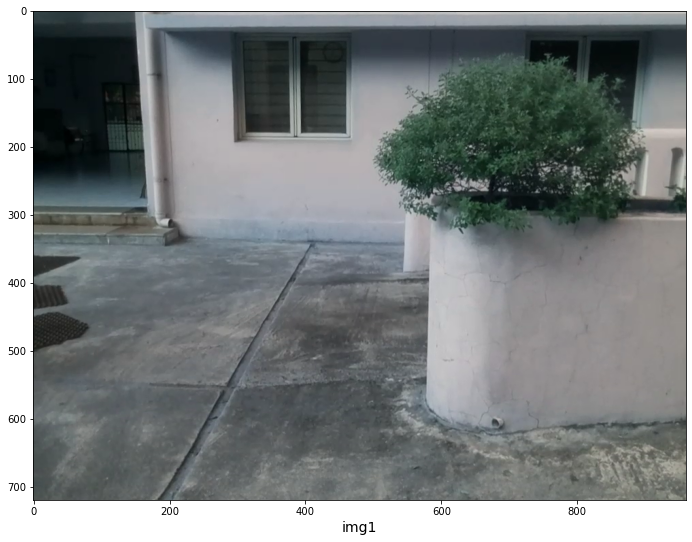

[[[295.  37.]
  [295. 190.]
  [460. 190.]
  [460.  37.]]]
(1, 4, 2)
[295, 37, 460, 190]


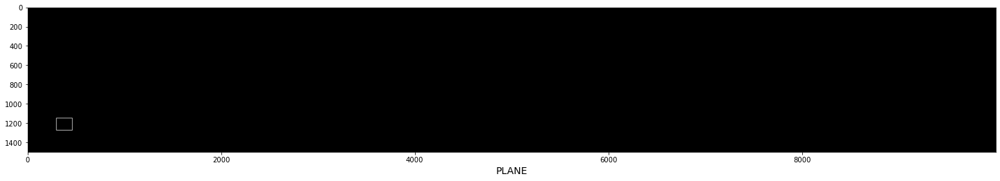

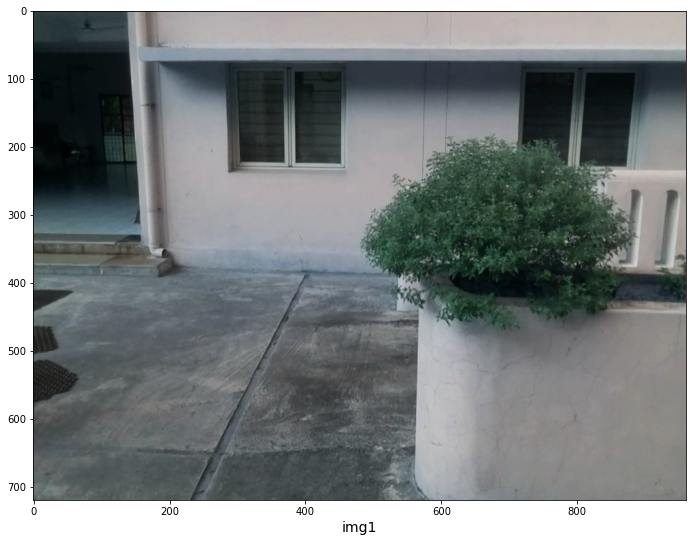

[[[277.  65.]
  [277. 255.]
  [487. 255.]
  [487.  65.]]

 [[693.  67.]
  [693. 250.]
  [893. 250.]
  [893.  67.]]]
(2, 4, 2)
[277, 65, 487, 255]
[693, 67, 893, 250]


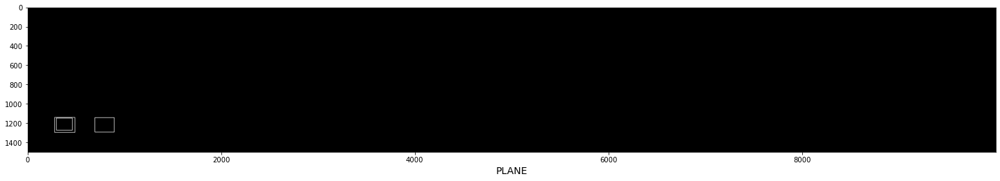

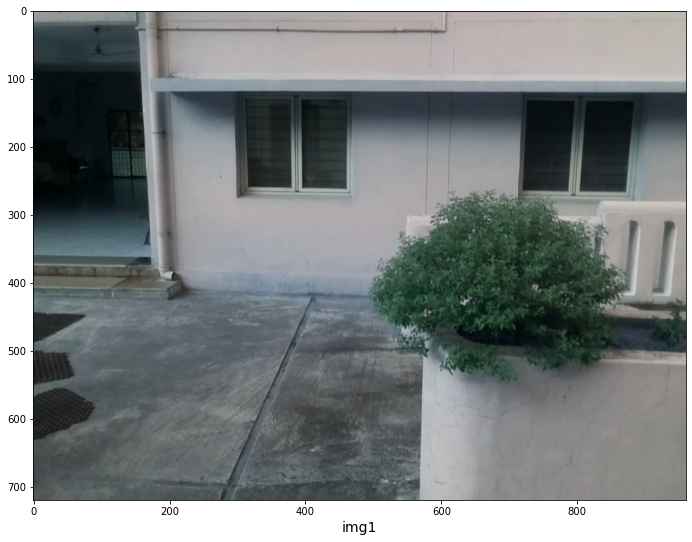

[[[286. 110.]
  [286. 292.]
  [491. 292.]
  [491. 110.]]

 [[703. 107.]
  [703. 287.]
  [896. 287.]
  [896. 107.]]]
(2, 4, 2)
[286, 110, 491, 292]
[703, 107, 896, 287]


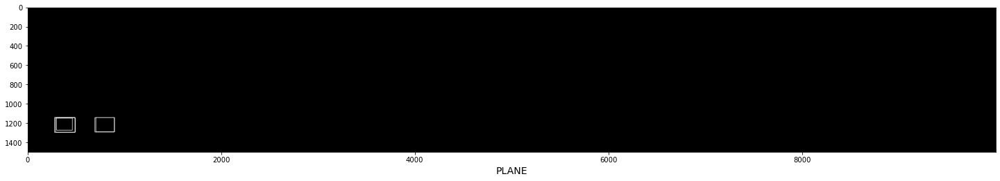

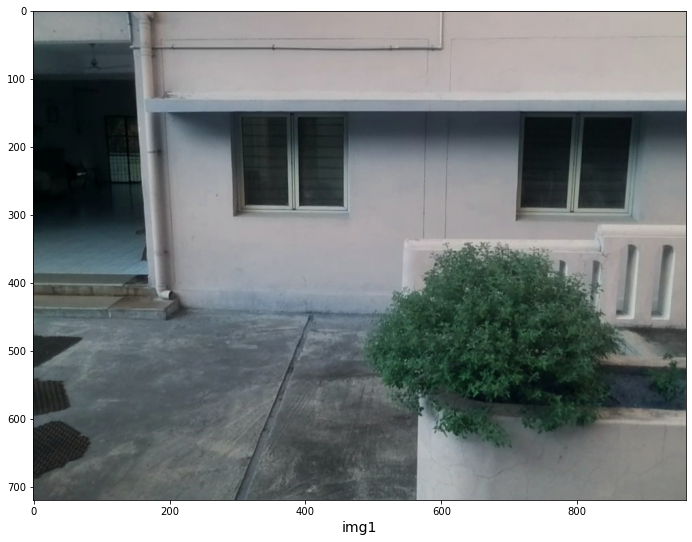

[[[282. 137.]
  [282. 317.]
  [490. 317.]
  [490. 137.]]

 [[694. 137.]
  [694. 315.]
  [889. 315.]
  [889. 137.]]]
(2, 4, 2)
[282, 137, 490, 317]
[694, 137, 889, 315]


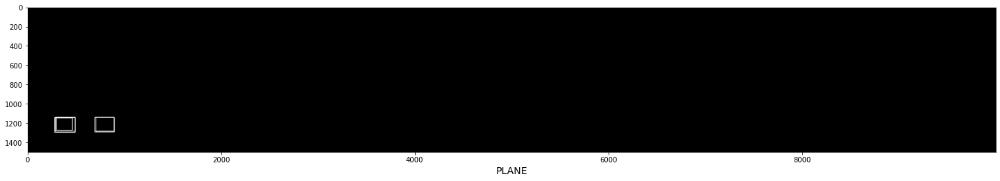

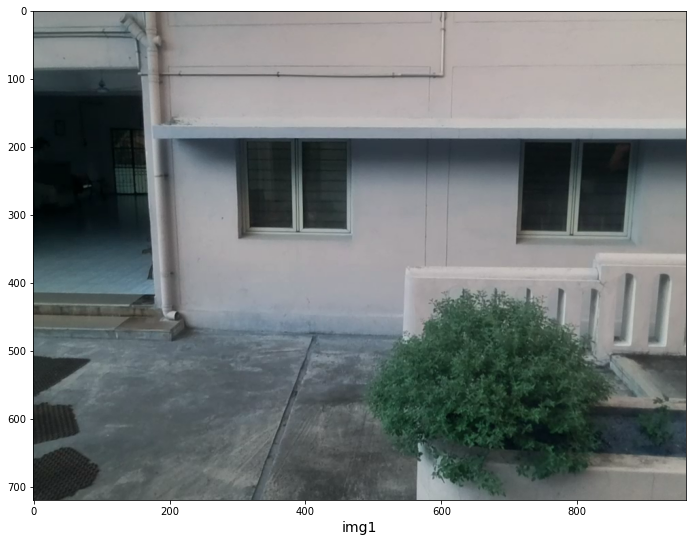

[[[288. 180.]
  [288. 352.]
  [493. 352.]
  [493. 180.]]

 [[698. 177.]
  [698. 347.]
  [888. 347.]
  [888. 177.]]]
(2, 4, 2)
[288, 180, 493, 352]
[698, 177, 888, 347]


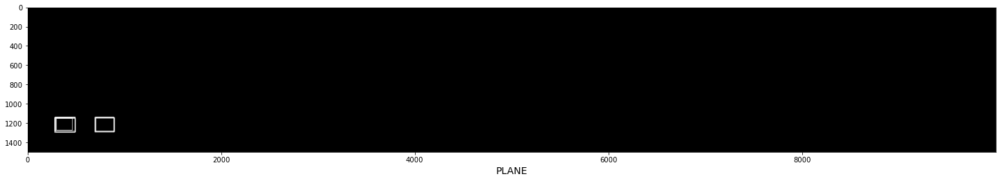

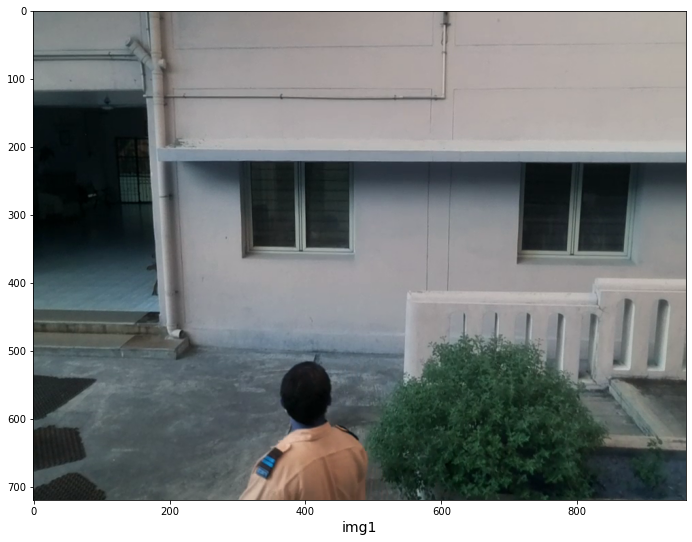

[[[294. 212.]
  [294. 380.]
  [494. 380.]
  [494. 212.]]

 [[696. 212.]
  [696. 375.]
  [884. 375.]
  [884. 212.]]]
(2, 4, 2)
[294, 212, 494, 380]
[696, 212, 884, 375]


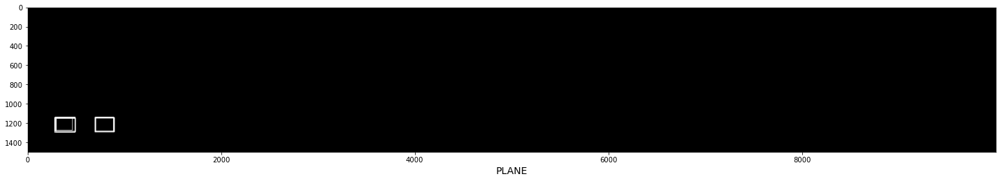

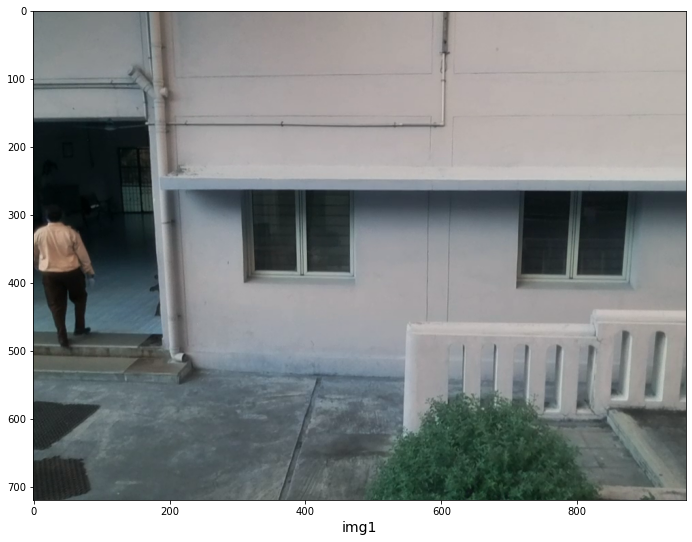

[[[296. 257.]
  [296. 417.]
  [496. 417.]
  [496. 257.]]

 [[698. 255.]
  [698. 412.]
  [886. 412.]
  [886. 255.]]]
(2, 4, 2)
[296, 257, 496, 417]
[698, 255, 886, 412]


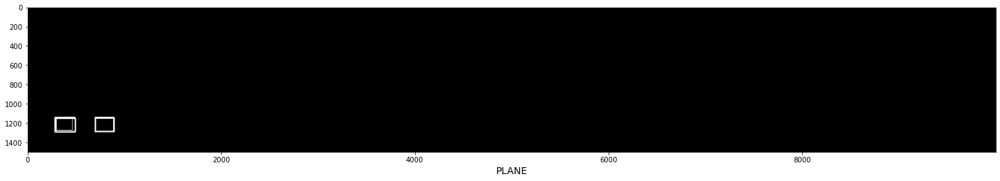

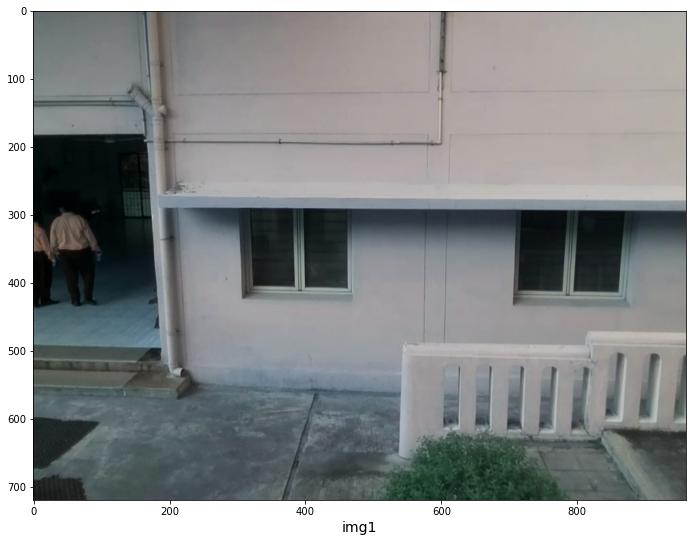

[[[292. 285.]
  [292. 442.]
  [492. 442.]
  [492. 285.]]

 [[694. 282.]
  [694. 437.]
  [879. 437.]
  [879. 282.]]]
(2, 4, 2)
[292, 285, 492, 442]
[694, 282, 879, 437]


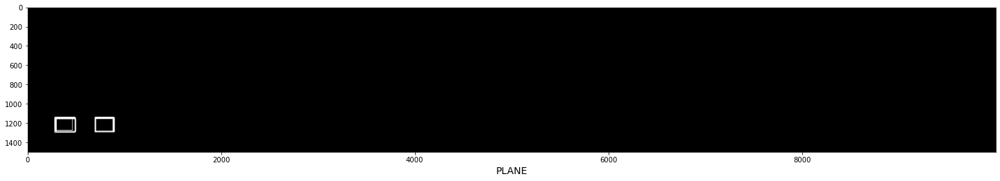

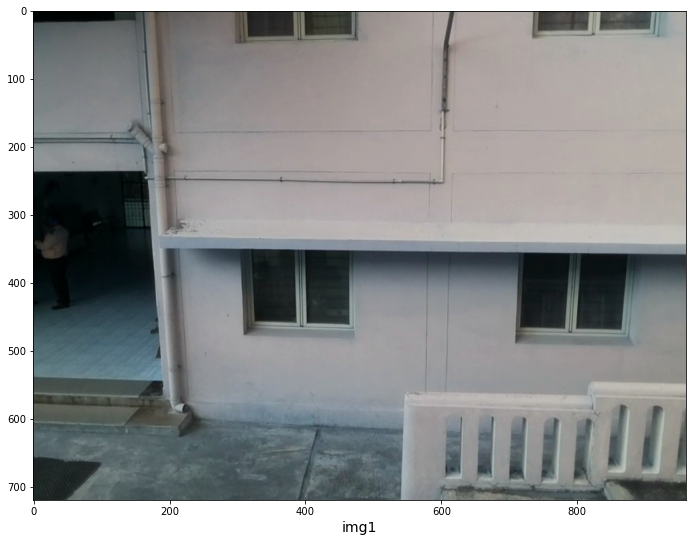

[[[295. 347.]
  [295. 497.]
  [495. 497.]
  [495. 347.]]

 [[699. 340.]
  [699. 490.]
  [887. 490.]
  [887. 340.]]]
(2, 4, 2)
[295, 347, 495, 497]
[699, 340, 887, 490]


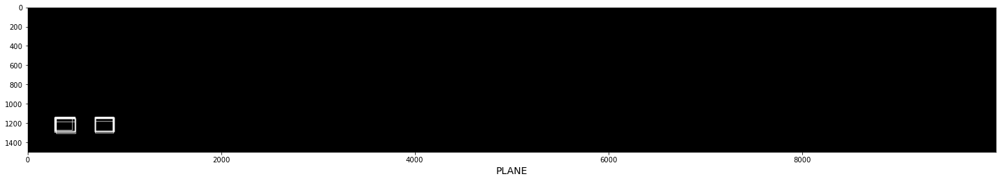

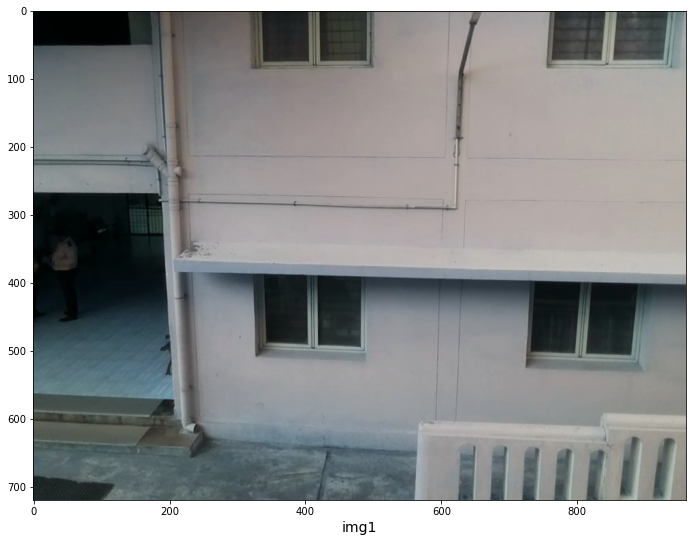

[[[735. 402.]
  [735. 522.]
  [887. 522.]
  [887. 402.]]

 [[330. 395.]
  [330. 505.]
  [487. 505.]
  [487. 395.]]

 [[744.   0.]
  [744. 100.]
  [951. 100.]
  [951.   0.]]

 [[306.   0.]
  [306.  97.]
  [525.  97.]
  [525.   0.]]]
(4, 4, 2)
[735, 402, 887, 522]
[330, 395, 487, 505]
[744, 0, 951, 100]
[306, 0, 525, 97]


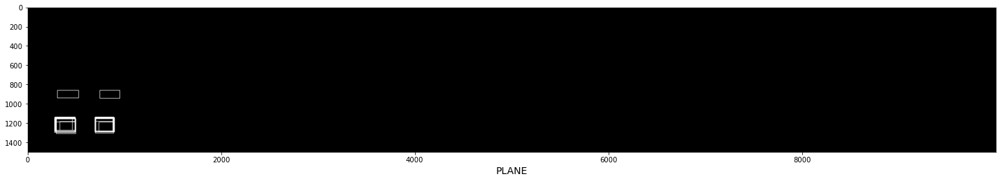

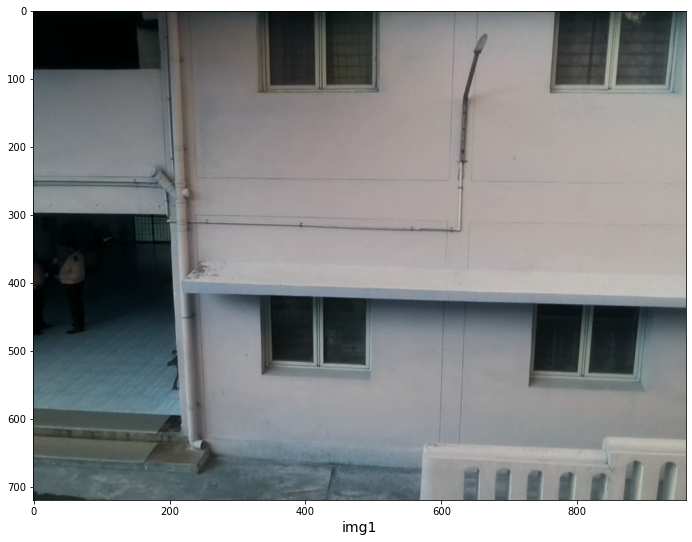

[[[737. 437.]
  [737. 550.]
  [892. 550.]
  [892. 437.]]

 [[340. 425.]
  [340. 535.]
  [492. 535.]
  [492. 425.]]

 [[315.   0.]
  [315. 135.]
  [529. 135.]
  [529.   0.]]

 [[748.   0.]
  [748. 132.]
  [951. 132.]
  [951.   0.]]]
(4, 4, 2)
[737, 437, 892, 550]
[340, 425, 492, 535]
[315, 0, 529, 135]
[748, 0, 951, 132]


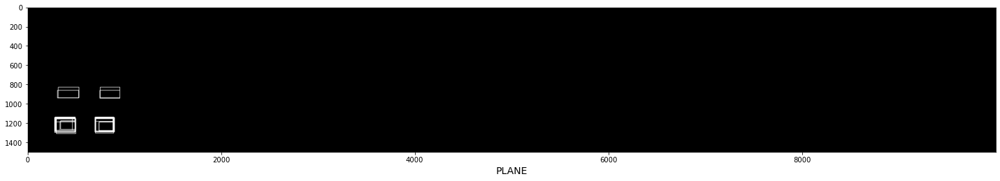

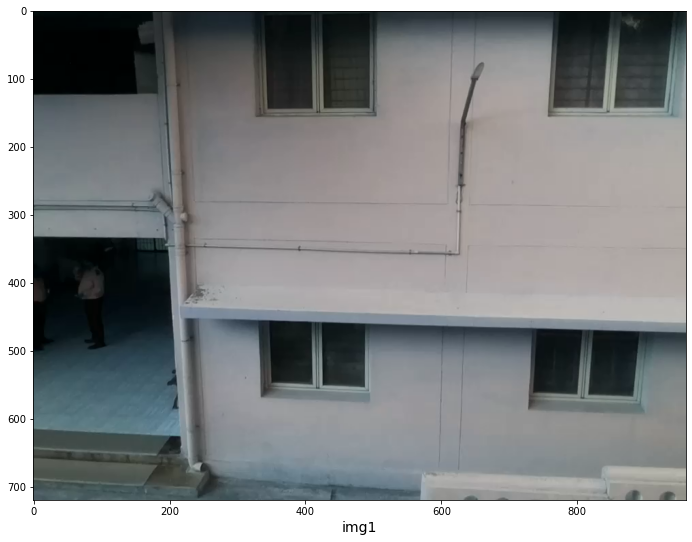

[[[735. 475.]
  [735. 585.]
  [895. 585.]
  [895. 475.]]

 [[335. 465.]
  [335. 565.]
  [492. 565.]
  [492. 465.]]

 [[743.   0.]
  [743. 170.]
  [948. 170.]
  [948.   0.]]

 [[327.   2.]
  [327. 155.]
  [502. 155.]
  [502.   2.]]]
(4, 4, 2)
[735, 475, 895, 585]
[335, 465, 492, 565]
[743, 0, 948, 170]
[327, 2, 502, 155]


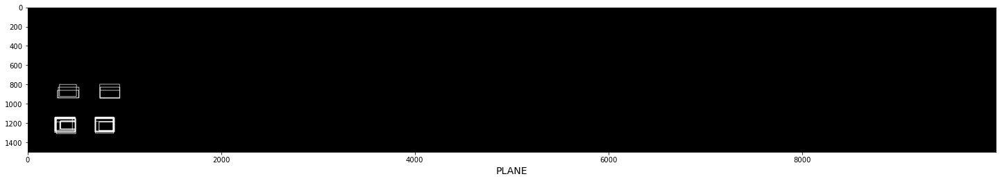

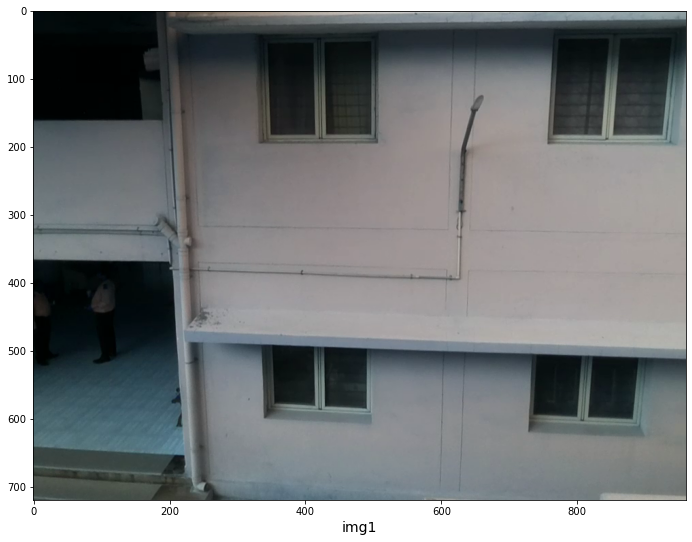

[[[737. 512.]
  [737. 617.]
  [890. 617.]
  [890. 512.]]

 [[342. 500.]
  [342. 597.]
  [495. 597.]
  [495. 500.]]

 [[765.  30.]
  [765. 197.]
  [945. 197.]
  [945.  30.]]

 [[327.  40.]
  [327. 192.]
  [505. 192.]
  [505.  40.]]]
(4, 4, 2)
[737, 512, 890, 617]
[342, 500, 495, 597]
[765, 30, 945, 197]
[327, 40, 505, 192]


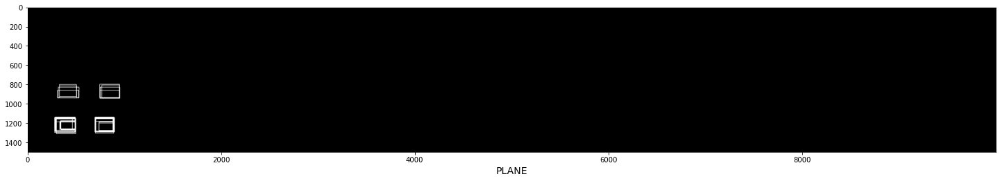

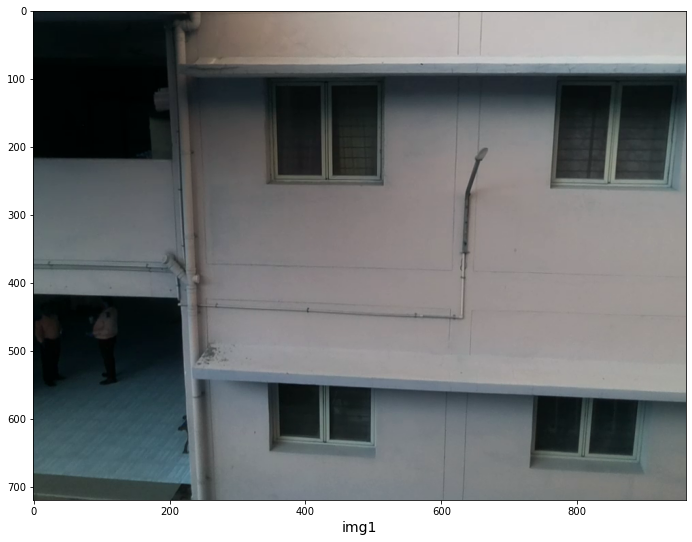

[[[735. 575.]
  [735. 670.]
  [892. 670.]
  [892. 575.]]

 [[350. 555.]
  [350. 650.]
  [500. 650.]
  [500. 555.]]

 [[322.  85.]
  [322. 277.]
  [536. 277.]
  [536.  85.]]

 [[751.  85.]
  [751. 267.]
  [954. 267.]
  [954.  85.]]]
(4, 4, 2)
[735, 575, 892, 670]
[350, 555, 500, 650]
[322, 85, 536, 277]
[751, 85, 954, 267]


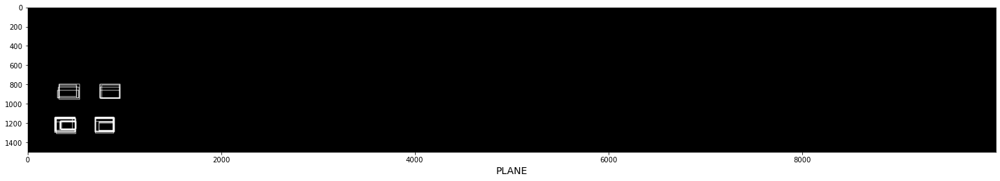

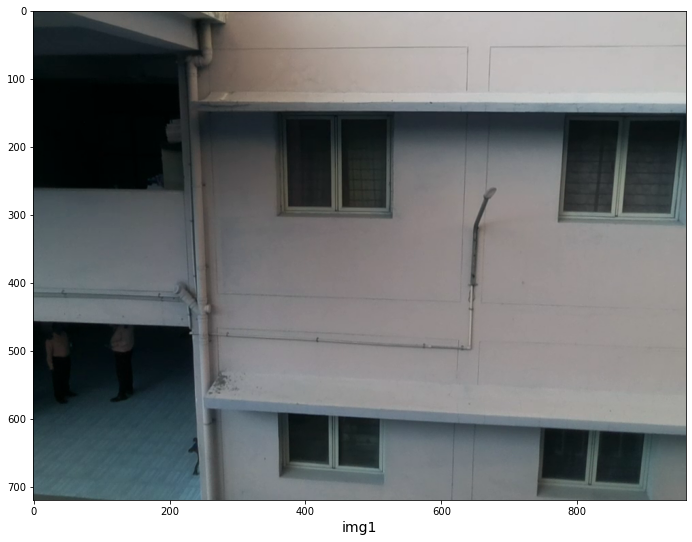

[[[747. 622.]
  [747. 710.]
  [900. 710.]
  [900. 622.]]

 [[367. 600.]
  [367. 685.]
  [512. 685.]
  [512. 600.]]

 [[346. 137.]
  [346. 325.]
  [543. 325.]
  [543. 137.]]

 [[762. 137.]
  [762. 317.]
  [960. 317.]
  [960. 137.]]]
(4, 4, 2)
[747, 622, 900, 710]
[367, 600, 512, 685]
[346, 137, 543, 325]
[762, 137, 959, 317]


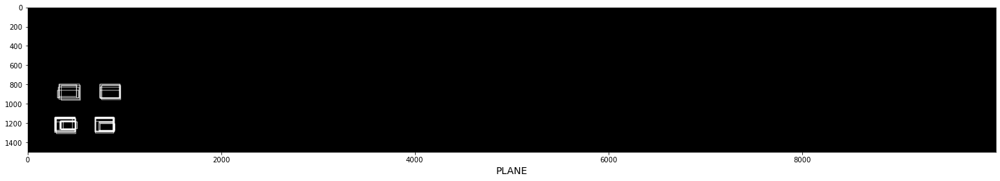

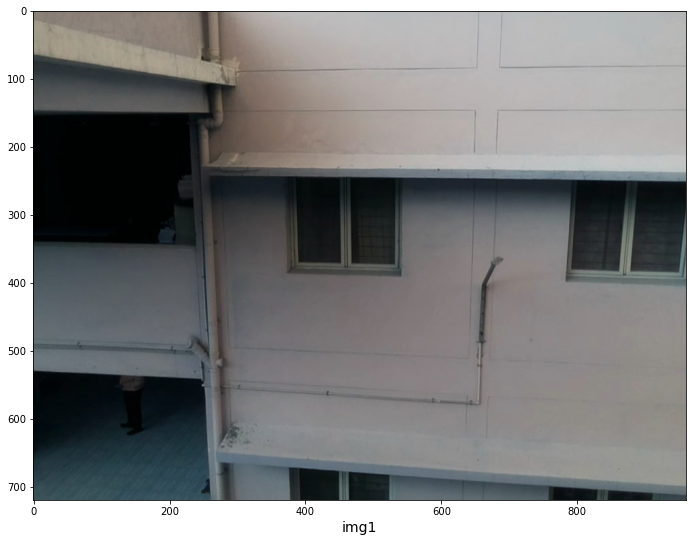

[[[792. 255.]
  [792. 395.]
  [957. 395.]
  [957. 255.]]

 [[377. 252.]
  [377. 385.]
  [540. 385.]
  [540. 252.]]]
(2, 4, 2)
[792, 255, 957, 395]
[377, 252, 540, 385]


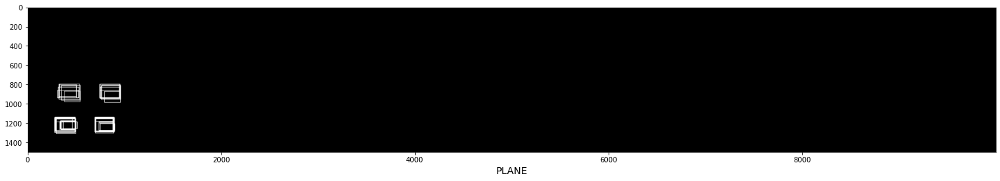

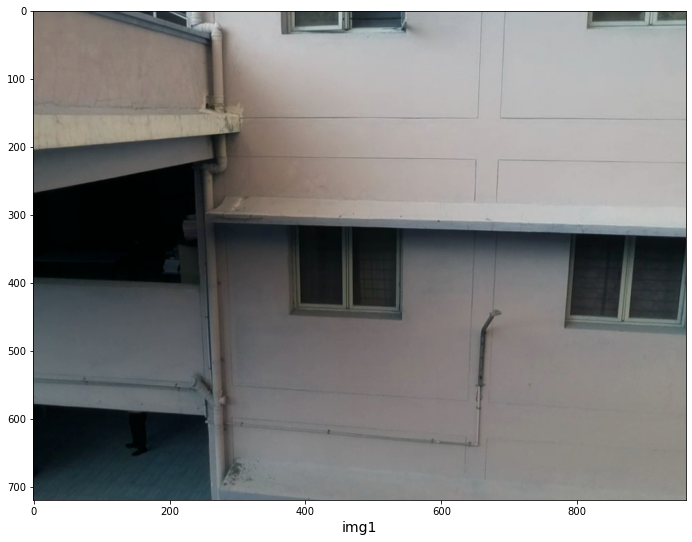

[[[790. 335.]
  [790. 467.]
  [957. 467.]
  [957. 335.]]

 [[382. 322.]
  [382. 447.]
  [540. 447.]
  [540. 322.]]]
(2, 4, 2)
[790, 335, 957, 467]
[382, 322, 540, 447]


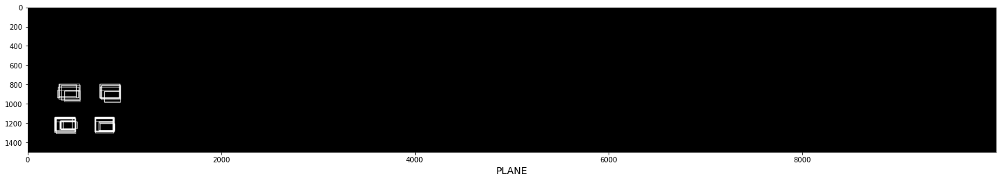

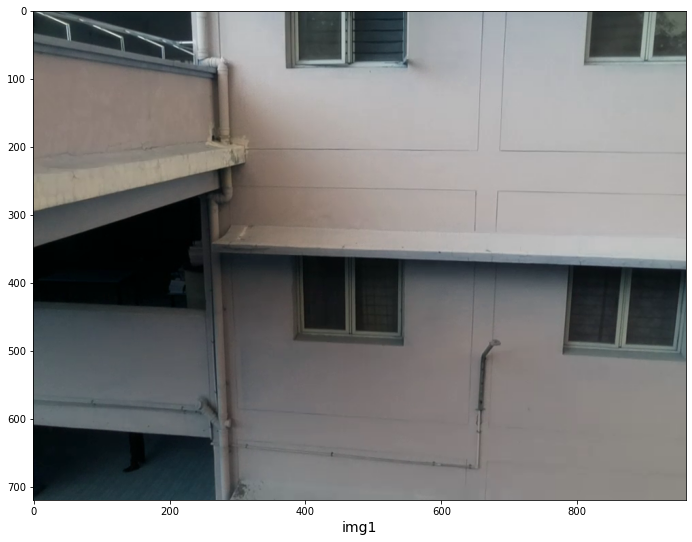

[[[785. 382.]
  [785. 507.]
  [957. 507.]
  [957. 382.]]

 [[390. 367.]
  [390. 487.]
  [545. 487.]
  [545. 367.]]

 [[377.   0.]
  [377.  77.]
  [552.  77.]
  [552.   0.]]]
(3, 4, 2)
[785, 382, 957, 507]
[390, 367, 545, 487]
[377, 0, 552, 77]


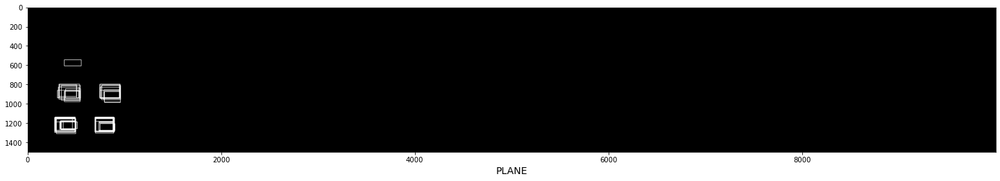

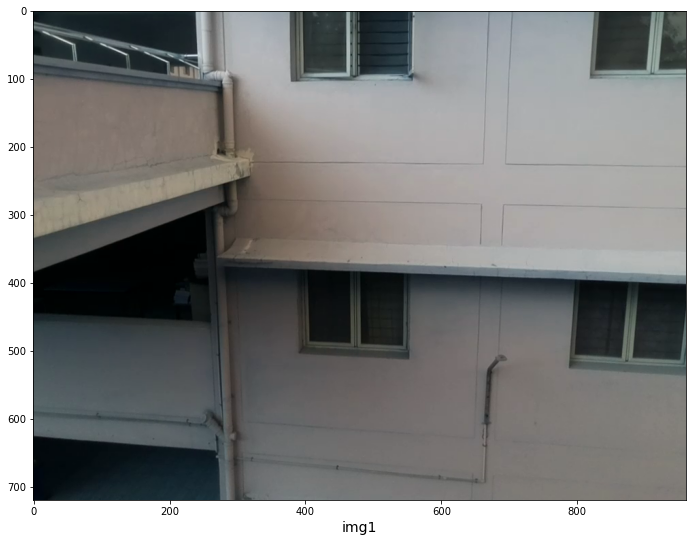

[[[795. 402.]
  [795. 525.]
  [957. 525.]
  [957. 402.]]

 [[395. 385.]
  [395. 507.]
  [550. 507.]
  [550. 385.]]

 [[356.   0.]
  [356. 112.]
  [513. 112.]
  [513.   0.]]

 [[827.   0.]
  [827.  90.]
  [957.  90.]
  [957.   0.]]]
(4, 4, 2)
[795, 402, 957, 525]
[395, 385, 550, 507]
[356, 0, 513, 112]
[827, 0, 957, 90]


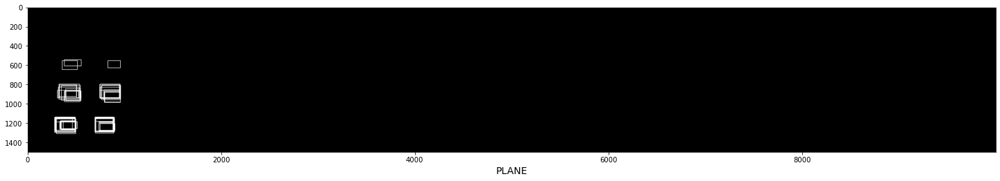

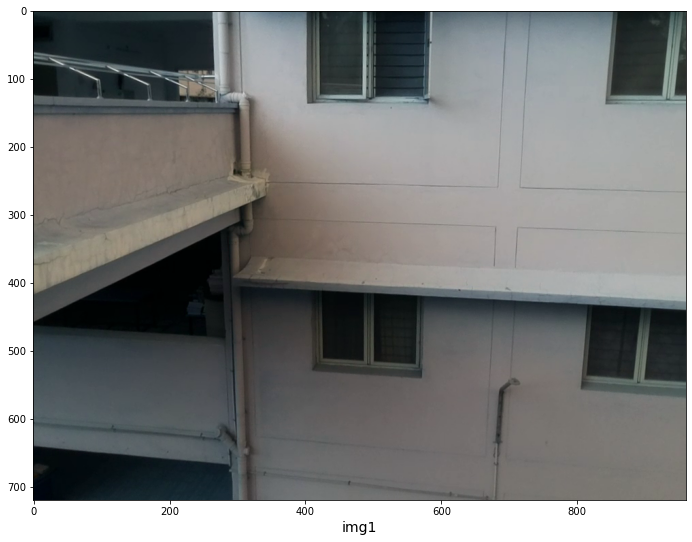

[[[817. 440.]
  [817. 555.]
  [957. 555.]
  [957. 440.]]

 [[420. 417.]
  [420. 535.]
  [567. 535.]
  [567. 417.]]

 [[405.   0.]
  [405. 135.]
  [580. 135.]
  [580.   0.]]]
(3, 4, 2)
[817, 440, 957, 555]
[420, 417, 567, 535]
[405, 0, 580, 135]


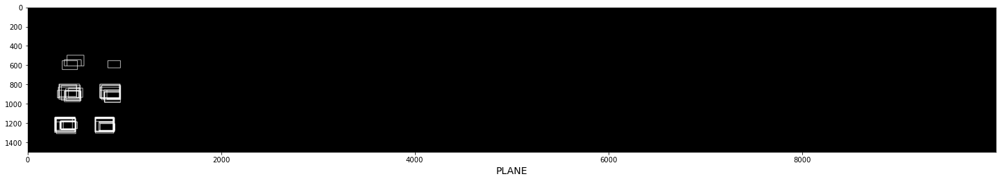

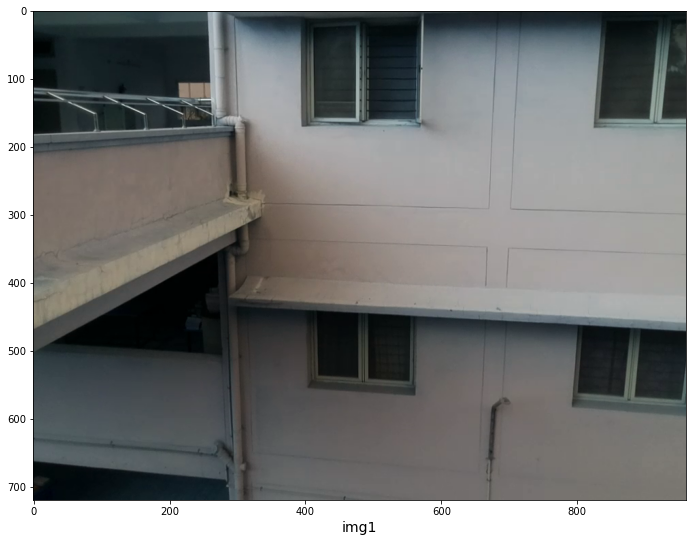

[[[802. 470.]
  [802. 582.]
  [957. 582.]
  [957. 470.]]

 [[410. 450.]
  [410. 562.]
  [560. 562.]
  [560. 450.]]

 [[395.  12.]
  [395. 167.]
  [575. 167.]
  [575.  12.]]]
(3, 4, 2)
[802, 470, 957, 582]
[410, 450, 560, 562]
[395, 12, 575, 167]


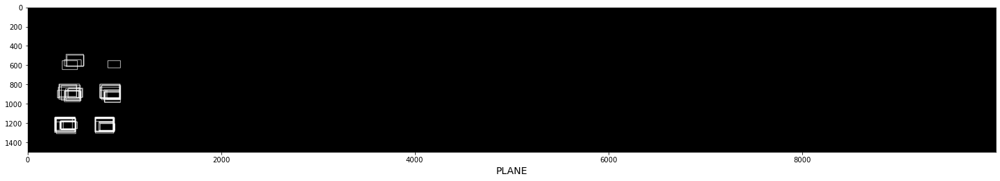

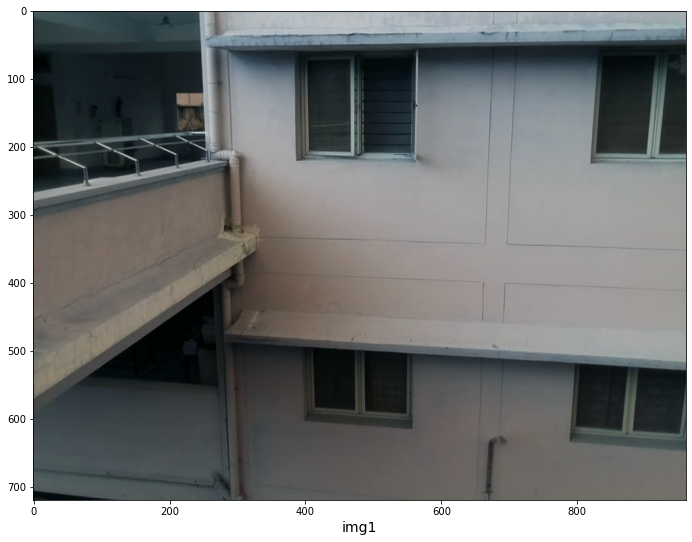

[[[802. 527.]
  [802. 632.]
  [957. 632.]
  [957. 527.]]

 [[402. 502.]
  [402. 607.]
  [557. 607.]
  [557. 502.]]

 [[387.  60.]
  [387. 220.]
  [567. 220.]
  [567.  60.]]]
(3, 4, 2)
[802, 527, 957, 632]
[402, 502, 557, 607]
[387, 60, 567, 220]


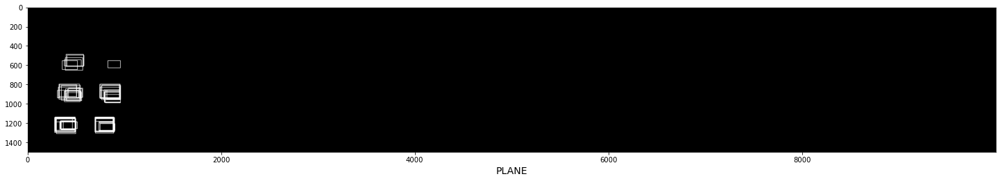

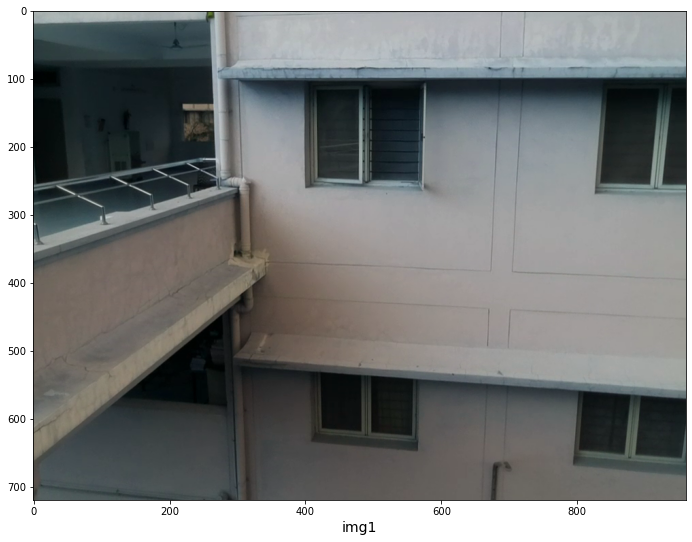

[[[805. 565.]
  [805. 670.]
  [957. 670.]
  [957. 565.]]

 [[415. 537.]
  [415. 645.]
  [567. 645.]
  [567. 537.]]

 [[378.  90.]
  [378. 282.]
  [525. 282.]
  [525.  90.]]

 [[837. 105.]
  [837. 267.]
  [945. 267.]
  [945. 105.]]]
(4, 4, 2)
[805, 565, 957, 670]
[415, 537, 567, 645]
[378, 90, 525, 282]
[837, 105, 945, 267]


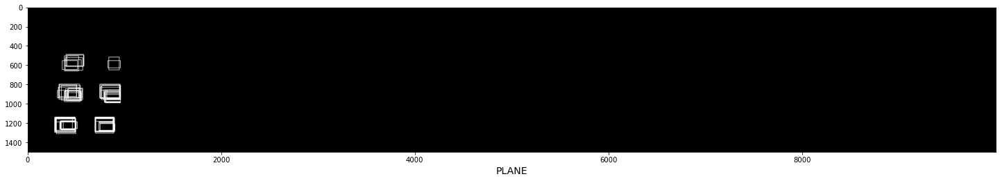

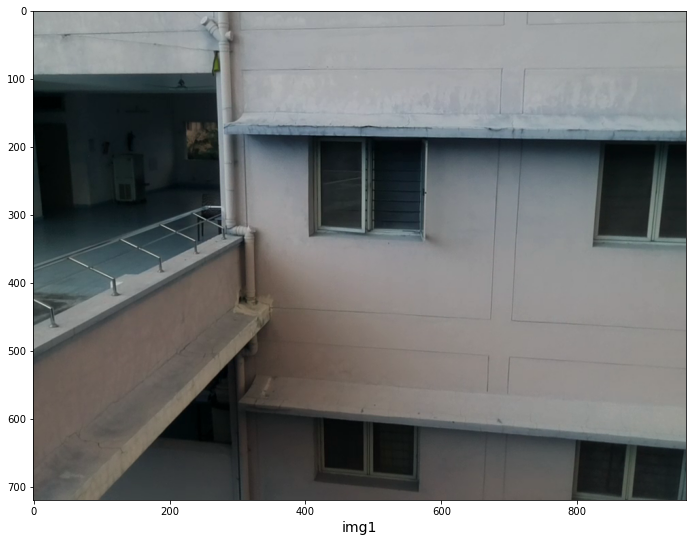

[[[800. 637.]
  [800. 727.]
  [957. 727.]
  [957. 637.]]

 [[420. 605.]
  [420. 702.]
  [565. 702.]
  [565. 605.]]

 [[382. 175.]
  [382. 362.]
  [534. 362.]
  [534. 175.]]

 [[835. 195.]
  [835. 347.]
  [957. 347.]
  [957. 195.]]]
(4, 4, 2)
[800, 637, 957, 719]
[420, 605, 565, 702]
[382, 175, 534, 362]
[835, 195, 957, 347]


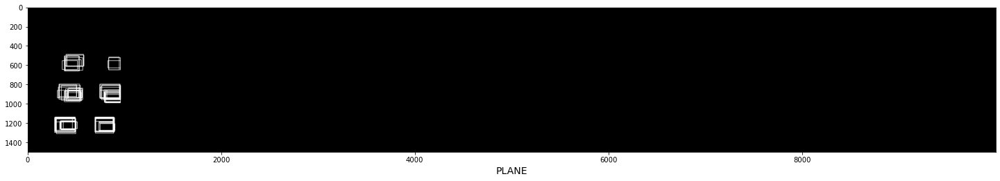

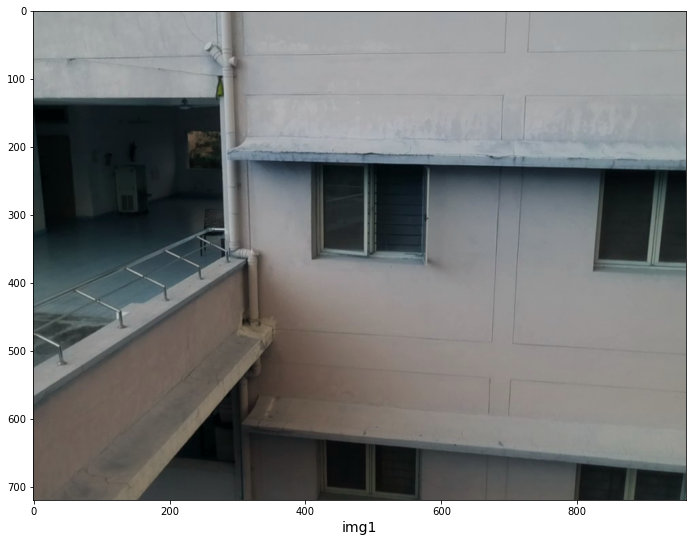

[[[427. 635.]
  [427. 725.]
  [565. 725.]
  [565. 635.]]

 [[832. 237.]
  [832. 375.]
  [955. 375.]
  [955. 237.]]

 [[415. 227.]
  [415. 370.]
  [577. 370.]
  [577. 227.]]]
(3, 4, 2)
[427, 635, 565, 719]
[832, 237, 955, 375]
[415, 227, 577, 370]


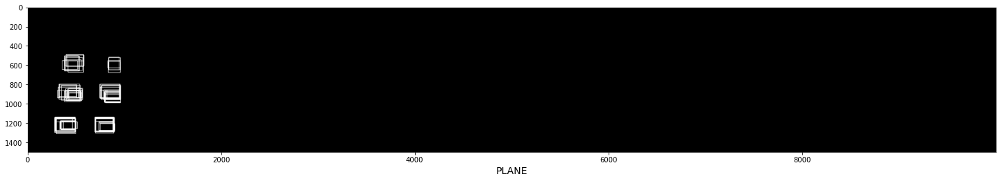

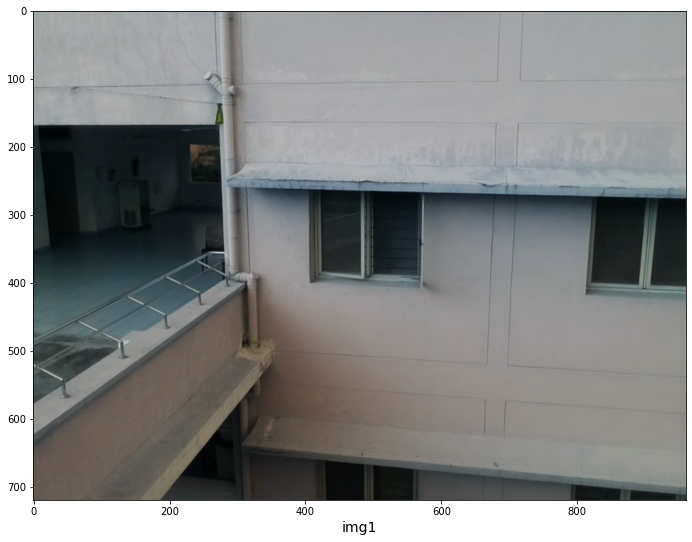

[[[825. 282.]
  [825. 412.]
  [957. 412.]
  [957. 282.]]

 [[410. 270.]
  [410. 405.]
  [575. 405.]
  [575. 270.]]]
(2, 4, 2)
[825, 282, 957, 412]
[410, 270, 575, 405]


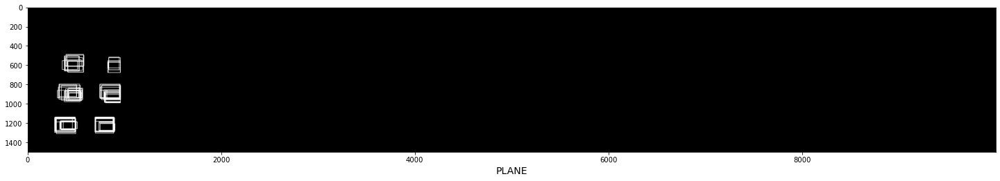

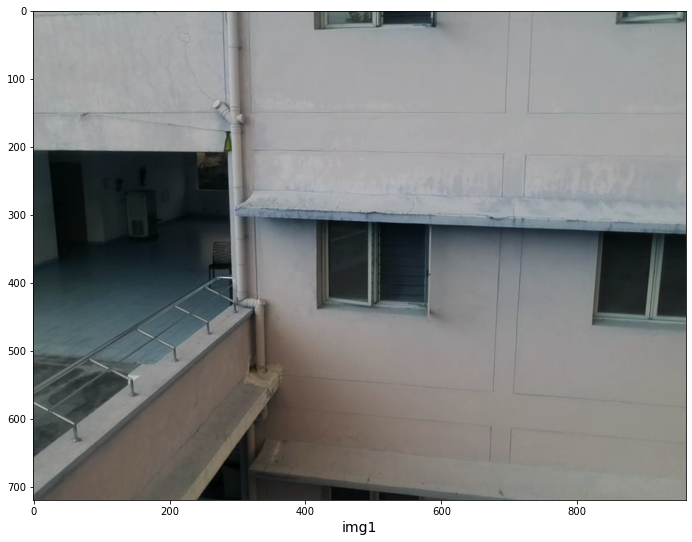

[[[832. 330.]
  [832. 457.]
  [957. 457.]
  [957. 330.]]

 [[420. 315.]
  [420. 445.]
  [580. 445.]
  [580. 315.]]]
(2, 4, 2)
[832, 330, 957, 457]
[420, 315, 580, 445]


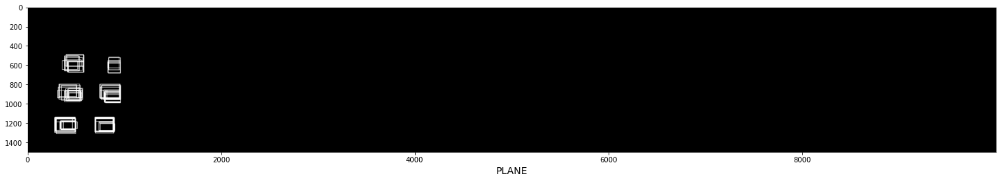

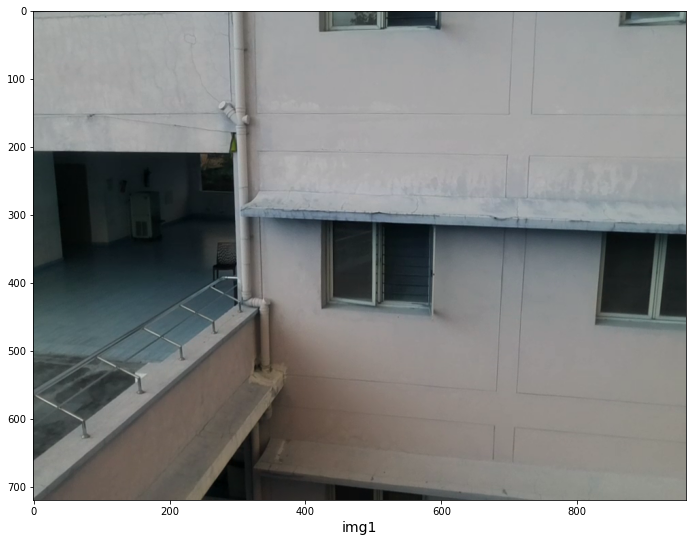

[[[837. 330.]
  [837. 457.]
  [957. 457.]
  [957. 330.]]

 [[427. 315.]
  [427. 445.]
  [585. 445.]
  [585. 315.]]]
(2, 4, 2)
[837, 330, 957, 457]
[427, 315, 585, 445]


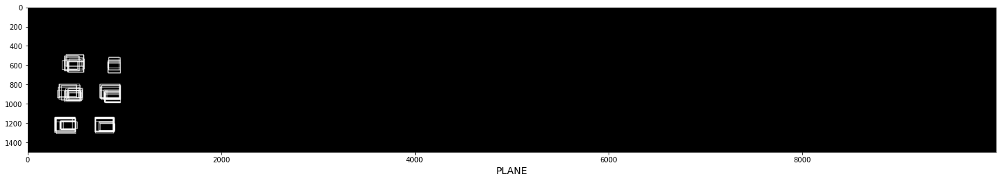

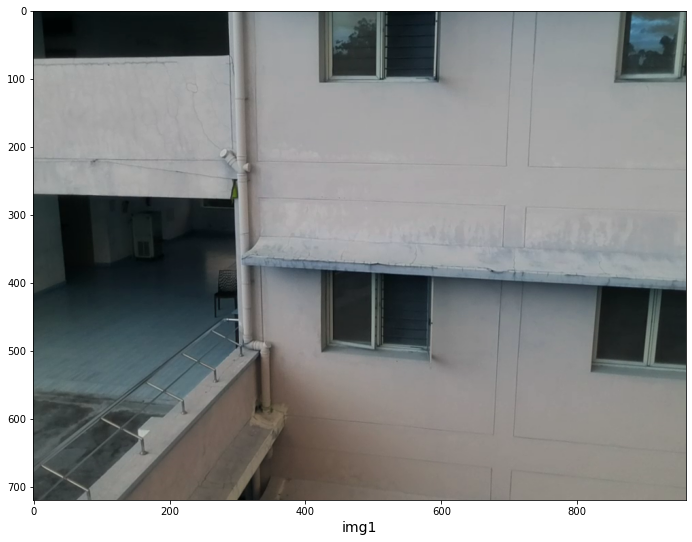

[[[830. 410.]
  [830. 527.]
  [947. 527.]
  [947. 410.]]

 [[430. 387.]
  [430. 510.]
  [582. 510.]
  [582. 387.]]

 [[422.   0.]
  [422. 107.]
  [602. 107.]
  [602.   0.]]]
(3, 4, 2)
[830, 410, 947, 527]
[430, 387, 582, 510]
[422, 0, 602, 107]


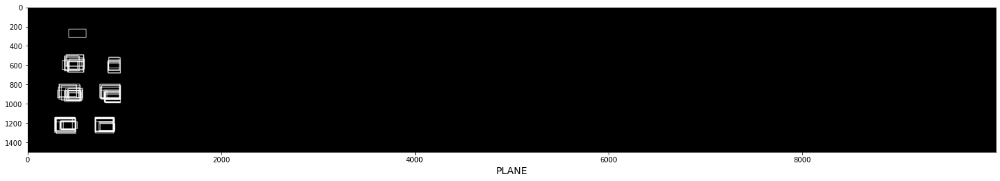

before NMS: [[ 295 1188  495 1310]
 [ 699 1183  887 1305]
 [ 802  905  957  991]
 [ 377  871  540  979]
 [ 832  581  957  685]
 [ 420  569  580  675]
 [ 422  229  602  316]]


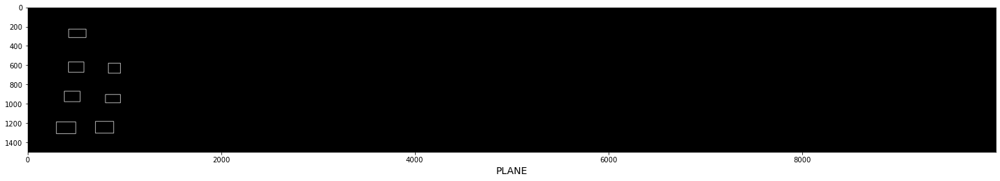

(7, 4)
after NMS: [[ 295 1188  495 1310]
 [ 699 1183  887 1305]
 [ 802  905  957  991]
 [ 377  871  540  979]
 [ 832  581  957  685]
 [ 420  569  580  675]
 [ 422  229  602  316]]
(7, 4)
finalBoxes [[ 295 1188  495 1310]
 [ 699 1183  887 1305]
 [ 802  905  957  991]
 [ 377  871  540  979]
 [ 832  581  957  685]
 [ 420  569  580  675]
 [ 422  229  602  316]]
finalBoxes shape (7, 4)


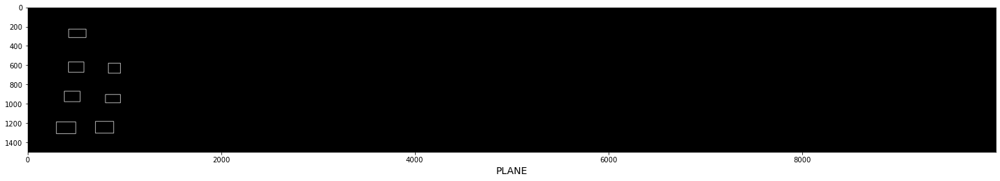

Total no. of windows in seq: 7
yAvg Heights: [ 251.   256.   552.   575.   867.   878.  1227.5]
avgStoreyHeights:  [253.5, 563.5, 872.5, 1227.5]
StoreyCount after running post processing module:  4
finallist 29
Total no. of windows in seq: 7
StoreyCount: 4
storeyHeights: [251.0, 552.0, 867.0, 1227.5]
FinalBoxes: [[ 295 1188  495 1310]
 [ 699 1183  887 1305]
 [ 802  905  957  991]
 [ 377  871  540  979]
 [ 832  581  957  685]
 [ 420  569  580  675]
 [ 422  229  602  316]]
FinalBoxes (in list): [array([ 295, 1188,  495, 1310]), array([ 699, 1183,  887, 1305]), array([802, 905, 957, 991]), array([377, 871, 540, 979]), array([832, 581, 957, 685]), array([420, 569, 580, 675]), array([422, 229, 602, 316])]
Diff in storeyheights: [301.  315.  360.5]
Diff in AvgStoreyHeights: [310. 309. 355.]
Offset Final: 138.5
final storey heights [ 115.  425.  734. 1089.]
Height difference between 2 consecutive stories of a single vertical sequence [310. 309. 355.]


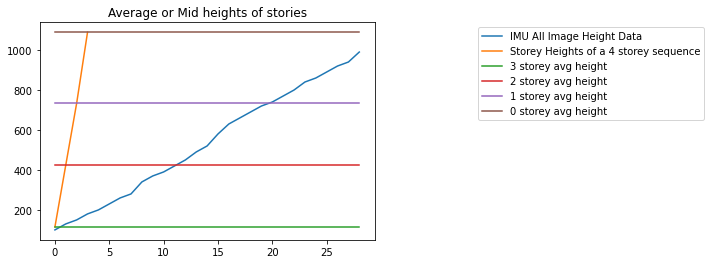

Final list size: 26
[90, 140, 170, 190, 220, 270, 300, 350, 400, 450, 470, 530, 560, 590, 630, 650, 680, 780, 810, 830, 850, 870, 900, 930, 970, 990]
['bakul3_002_00090.png', 'bakul3_002_000140.png', 'bakul3_002_000170.png', 'bakul3_002_000190.png', 'bakul3_002_000220.png', 'bakul3_002_000270.png', 'bakul3_002_000300.png', 'bakul3_002_000350.png', 'bakul3_002_000400.png', 'bakul3_002_000450.png', 'bakul3_002_000470.png', 'bakul3_002_000530.png', 'bakul3_002_000560.png', 'bakul3_002_000590.png', 'bakul3_002_000620.png', 'bakul3_002_000650.png', 'bakul3_002_000680.png', 'bakul3_002_000780.png', 'bakul3_002_000810.png', 'bakul3_002_000830.png', 'bakul3_002_000850.png', 'bakul3_002_000870.png', 'bakul3_002_000900.png', 'bakul3_002_000930.png', 'bakul3_002_000970.png', 'bakul3_002_000990.png']
pitch:  [2, 1, 1, 0, 0, 1, 2, 2, 1, 1, 2, 2, 4, 3, 2, 3, 0, 0, 0, 1, 0, 0, 0, 1, 2, 1]
roll:  [1, 0, 2, 2, 3, 4, 3, 3, 3, 2, 1, 1, 0, 3, 2, 3, 3, 1, 0, 4, 1, 2, 2, 2, 1, 3]
yaw:  [65, 65, 64, 65, 65, 

<ipython-input-7-0e56a2c47fbf>:7: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data = read_csv(seqLogFile, sep = " , ", header=None) #read imu data file


../sample_seq_data/002_new/images\bakul3_002_000170.png
../sample_seq_data/002_new/images\bakul3_002_000190.png
../sample_seq_data/002_new/images\bakul3_002_000220.png
../sample_seq_data/002_new/images\bakul3_002_000270.png
../sample_seq_data/002_new/images\bakul3_002_000300.png
../sample_seq_data/002_new/images\bakul3_002_000350.png
../sample_seq_data/002_new/images\bakul3_002_000400.png
../sample_seq_data/002_new/images\bakul3_002_000450.png
../sample_seq_data/002_new/images\bakul3_002_000470.png
../sample_seq_data/002_new/images\bakul3_002_000530.png
../sample_seq_data/002_new/images\bakul3_002_000560.png
../sample_seq_data/002_new/images\bakul3_002_000590.png
../sample_seq_data/002_new/images\bakul3_002_000620.png
../sample_seq_data/002_new/images\bakul3_002_000650.png
../sample_seq_data/002_new/images\bakul3_002_000680.png
../sample_seq_data/002_new/images\bakul3_002_000780.png
../sample_seq_data/002_new/images\bakul3_002_000810.png
../sample_seq_data/002_new/images\bakul3_002_000

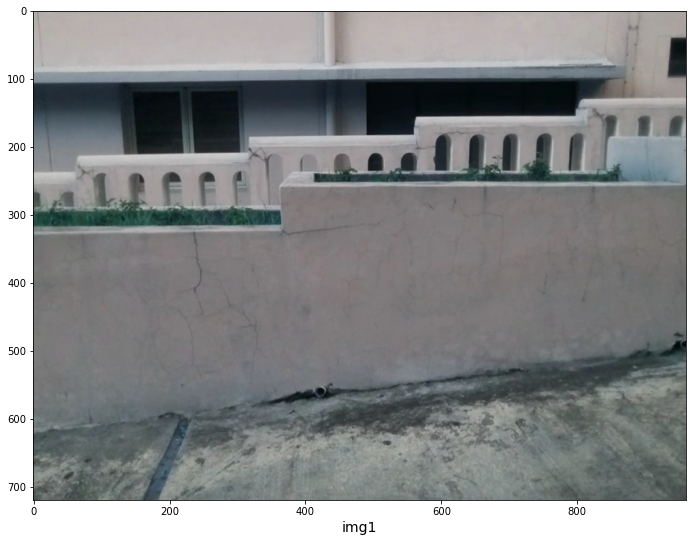

[[[137. 112.]
  [137. 215.]
  [305. 215.]
  [305. 112.]]]
(1, 4, 2)
[137, 112, 305, 215]


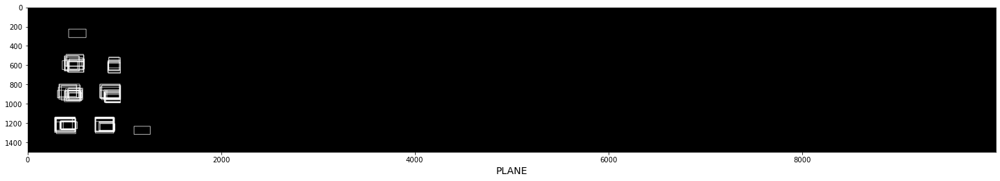

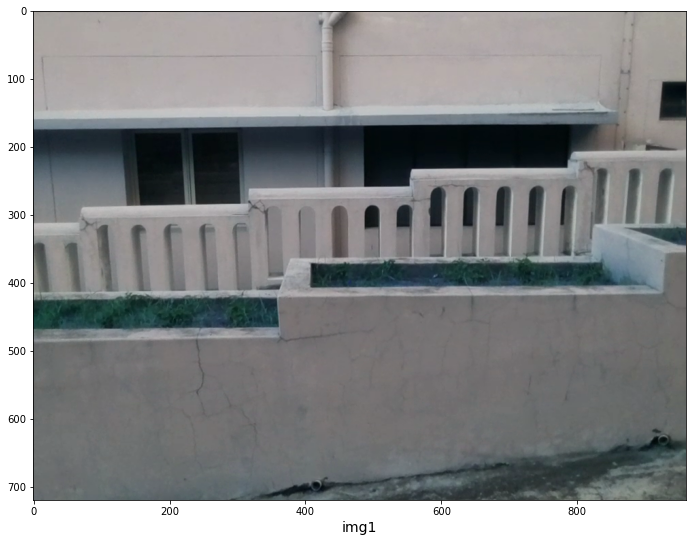

[[[nan nan]
  [nan nan]
  [nan nan]
  [nan nan]]]
(1, 4, 2)
Skipping as there is no window


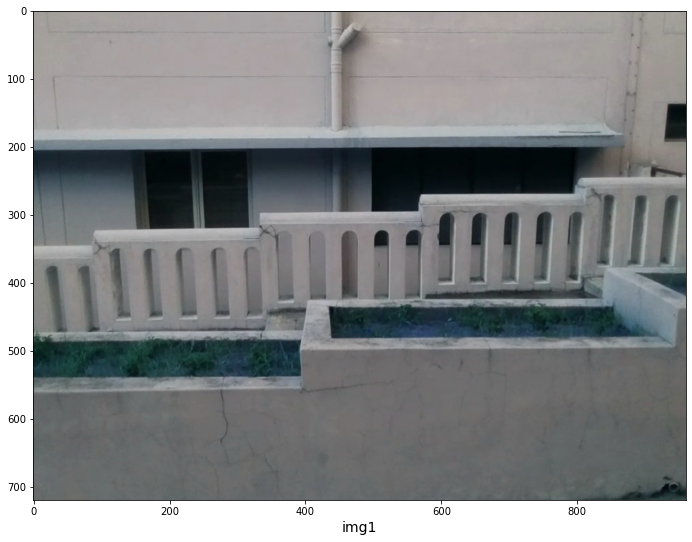

[[[150. 215.]
  [150. 322.]
  [317. 322.]
  [317. 215.]]]
(1, 4, 2)
[150, 215, 317, 322]


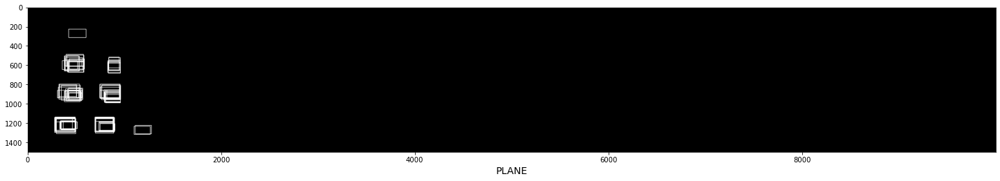

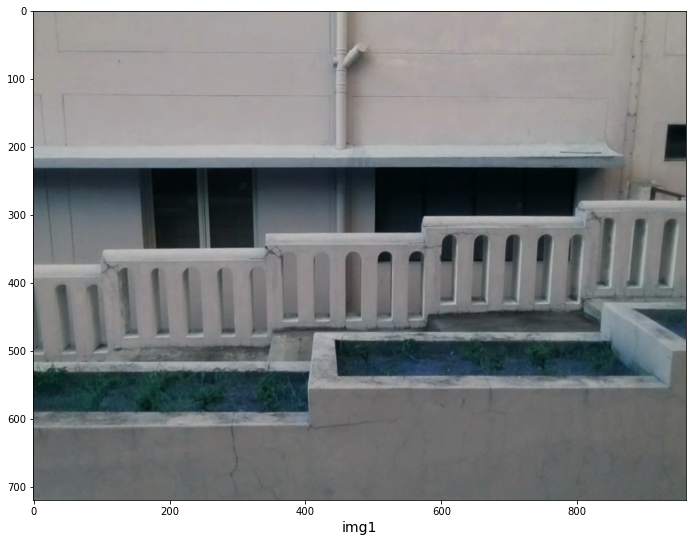

[[[162. 232.]
  [162. 355.]
  [327. 355.]
  [327. 232.]]]
(1, 4, 2)
[162, 232, 327, 355]


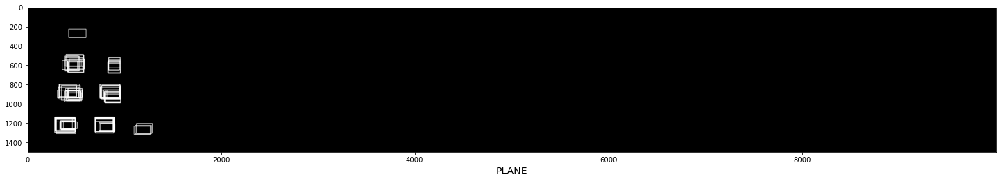

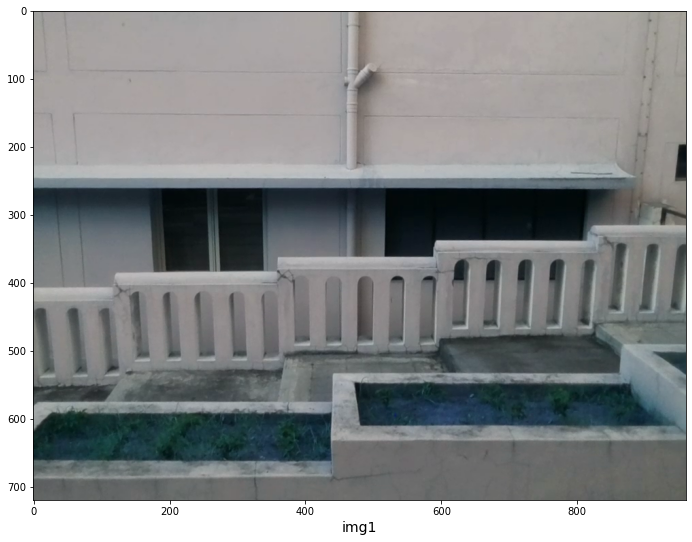

[[[177. 262.]
  [177. 387.]
  [340. 387.]
  [340. 262.]]]
(1, 4, 2)
[177, 262, 340, 387]


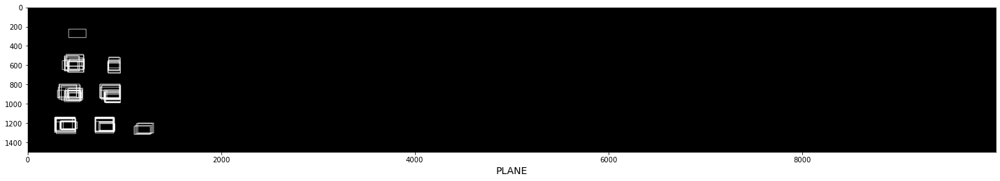

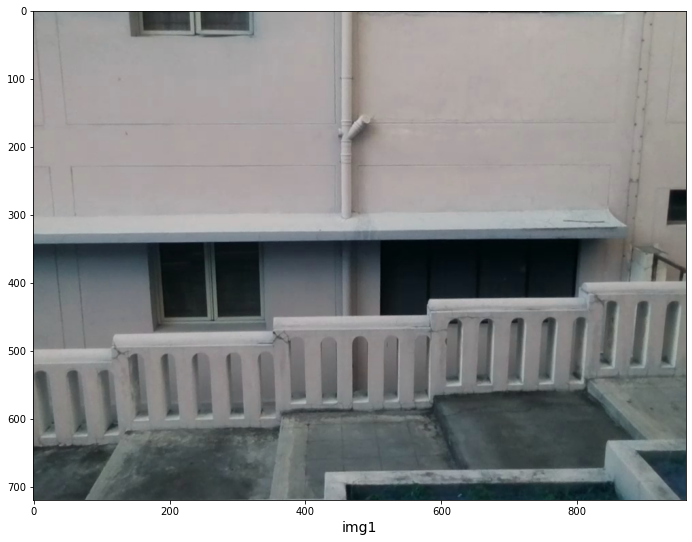

[[[175. 347.]
  [175. 460.]
  [337. 460.]
  [337. 347.]]]
(1, 4, 2)
[175, 347, 337, 460]


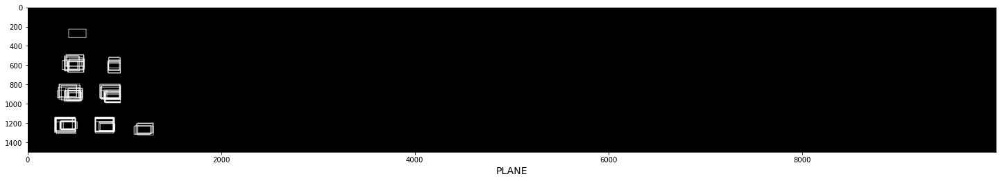

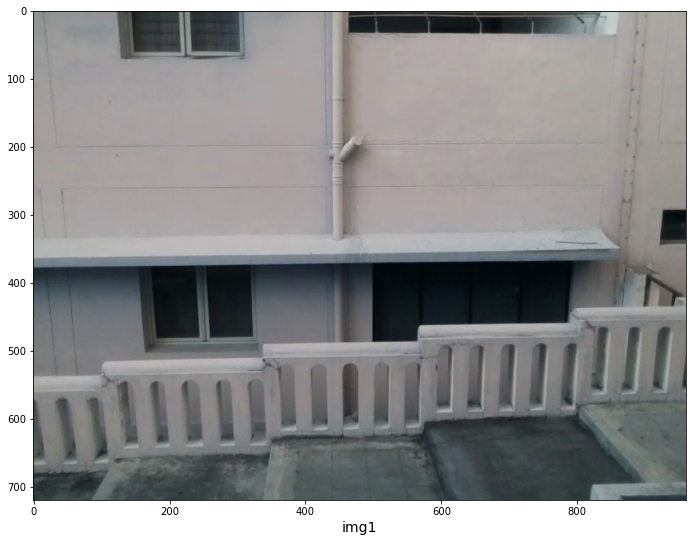

[[[162. 385.]
  [162. 487.]
  [325. 487.]
  [325. 385.]]

 [[132.   0.]
  [132.  70.]
  [312.  70.]
  [312.   0.]]]
(2, 4, 2)
[162, 385, 325, 487]
[132, 0, 312, 70]


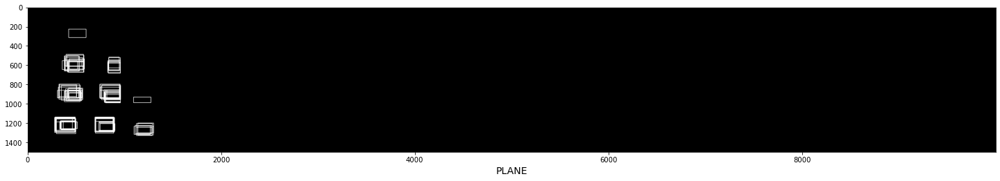

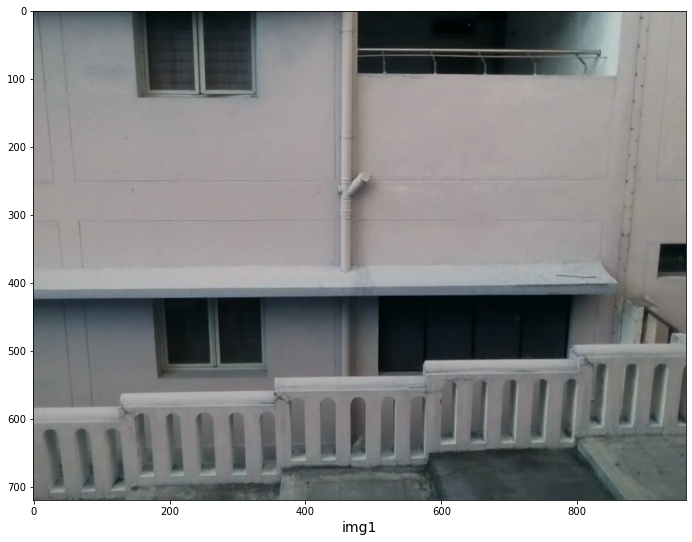

[[[180. 430.]
  [180. 527.]
  [337. 527.]
  [337. 430.]]

 [[155.   0.]
  [155. 125.]
  [322. 125.]
  [322.   0.]]]
(2, 4, 2)
[180, 430, 337, 527]
[155, 0, 322, 125]


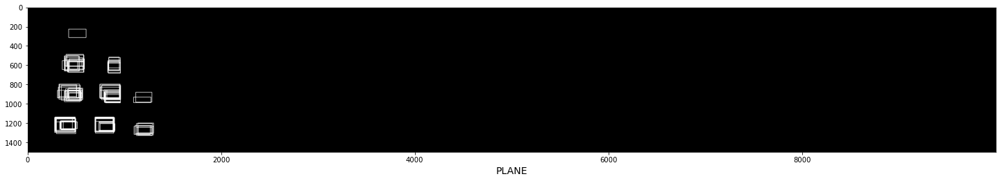

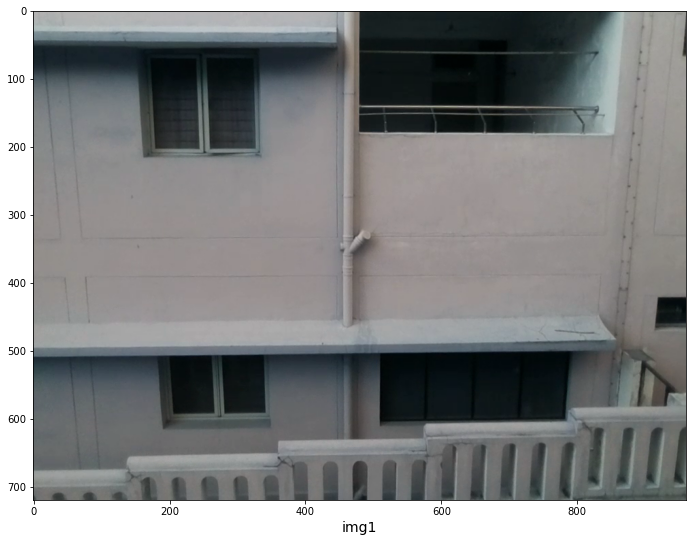

[[[187. 515.]
  [187. 602.]
  [340. 602.]
  [340. 515.]]

 [[155.  57.]
  [155. 212.]
  [332. 212.]
  [332.  57.]]]
(2, 4, 2)
[187, 515, 340, 602]
[155, 57, 332, 212]


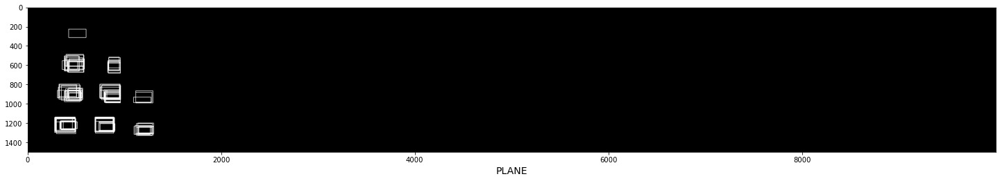

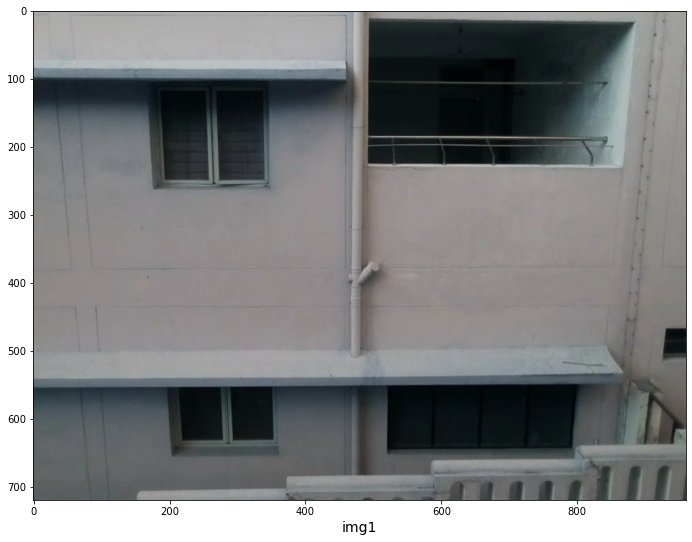

[[[205. 562.]
  [205. 642.]
  [355. 642.]
  [355. 562.]]

 [[172. 112.]
  [172. 260.]
  [342. 260.]
  [342. 112.]]]
(2, 4, 2)
[205, 562, 355, 642]
[172, 112, 342, 260]


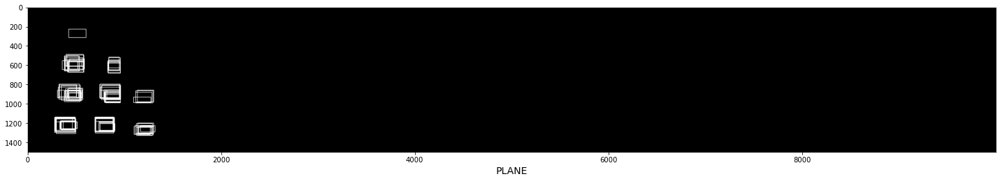

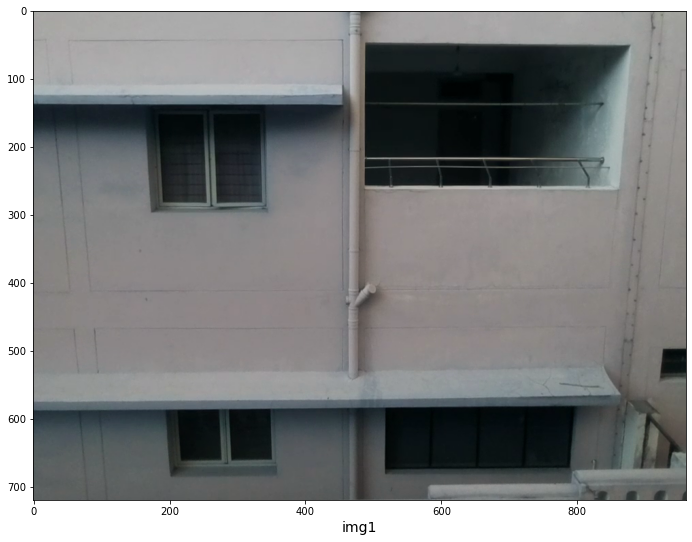

[[[200. 592.]
  [200. 677.]
  [355. 677.]
  [355. 592.]]

 [[172. 147.]
  [172. 290.]
  [340. 290.]
  [340. 147.]]]
(2, 4, 2)
[200, 592, 355, 677]
[172, 147, 340, 290]


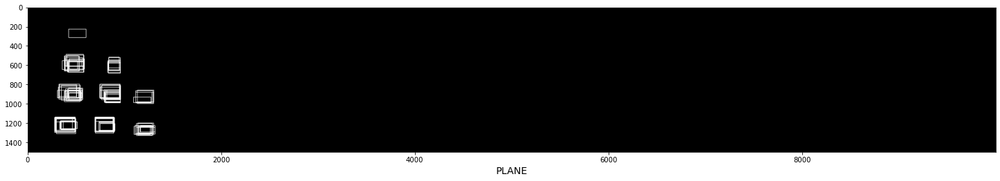

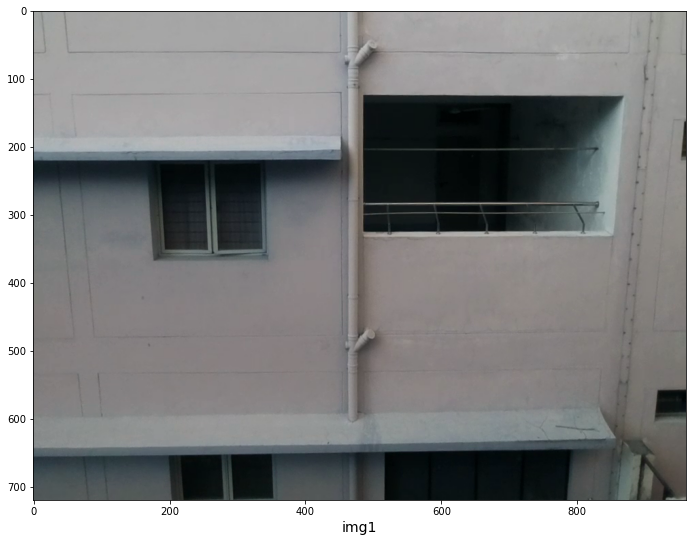

[[[172. 230.]
  [172. 360.]
  [340. 360.]
  [340. 230.]]]
(1, 4, 2)
[172, 230, 340, 360]


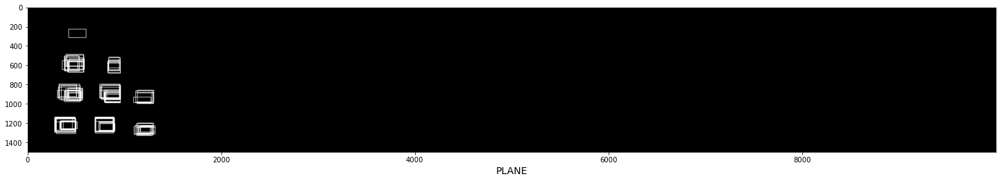

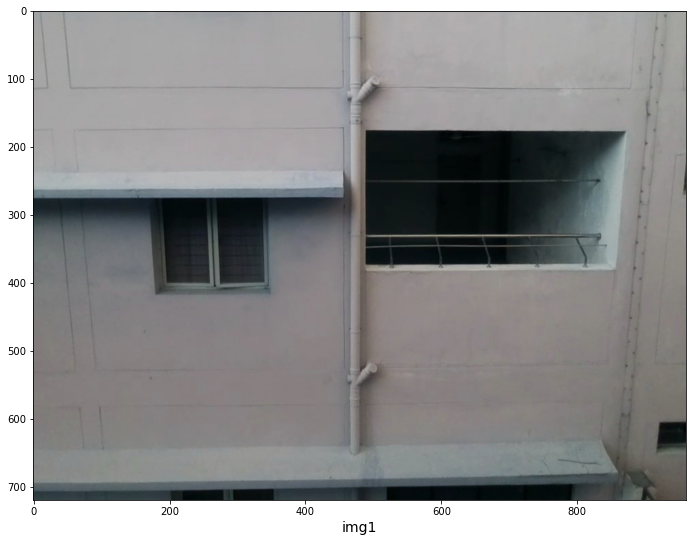

[[[177. 285.]
  [177. 410.]
  [340. 410.]
  [340. 285.]]]
(1, 4, 2)
[177, 285, 340, 410]


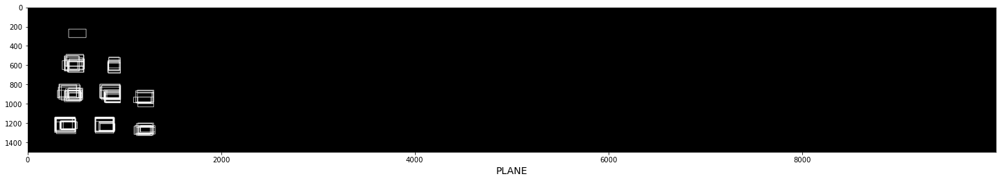

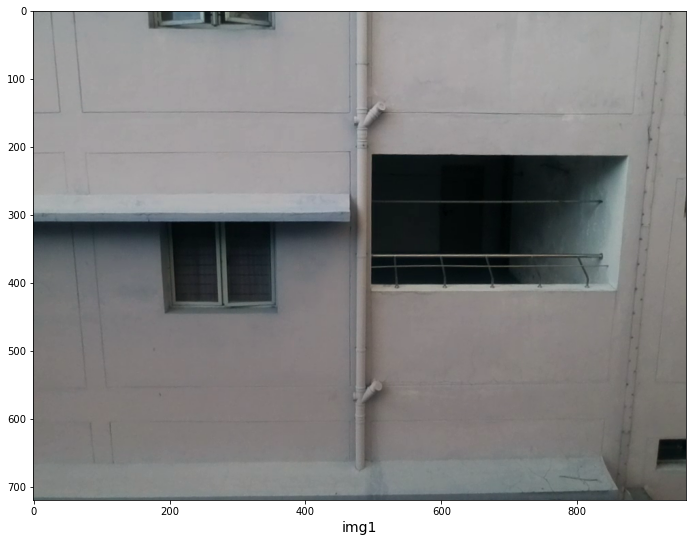

[[[187. 315.]
  [187. 437.]
  [352. 437.]
  [352. 315.]]]
(1, 4, 2)
[187, 315, 352, 437]


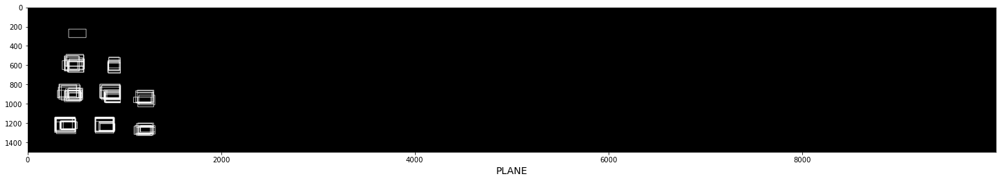

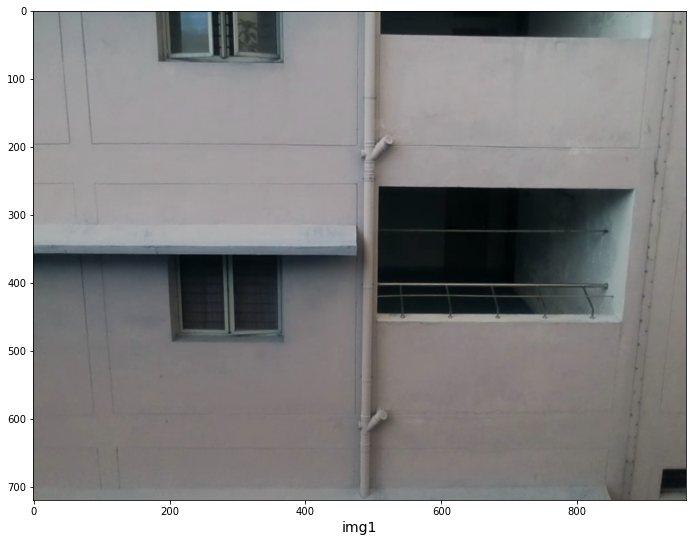

[[[202. 367.]
  [202. 482.]
  [365. 482.]
  [365. 367.]]]
(1, 4, 2)
[202, 367, 365, 482]


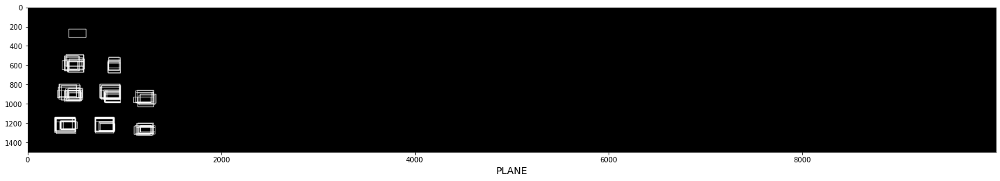

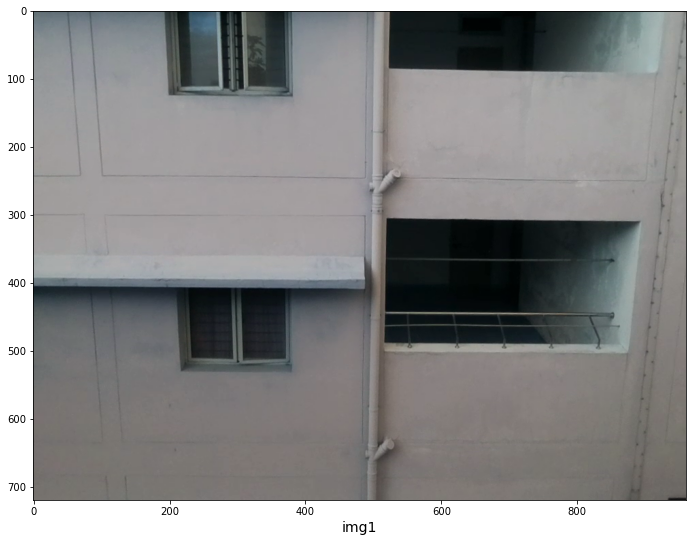

[[[215. 417.]
  [215. 522.]
  [375. 522.]
  [375. 417.]]

 [[202.   0.]
  [202. 125.]
  [372. 125.]
  [372.   0.]]]
(2, 4, 2)
[215, 417, 375, 522]
[202, 0, 372, 125]


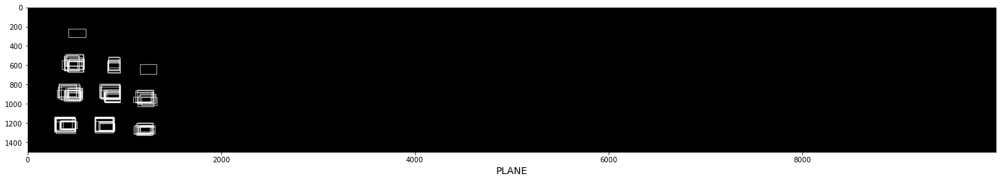

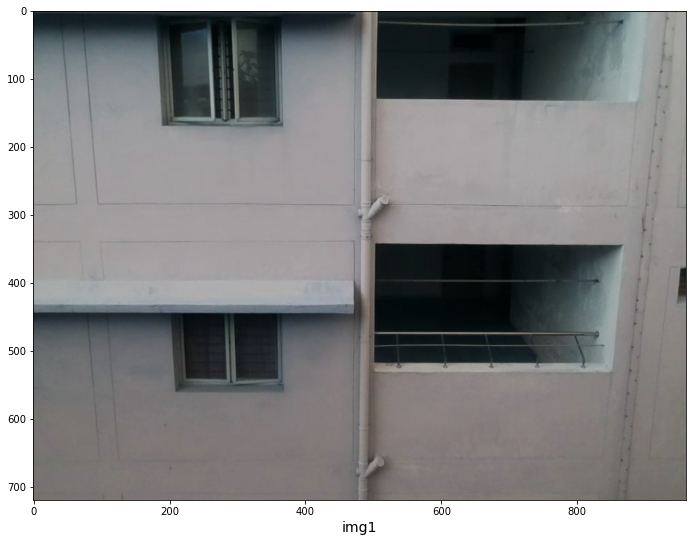

[[[207. 455.]
  [207. 555.]
  [365. 555.]
  [365. 455.]]

 [[187.  17.]
  [187. 167.]
  [357. 167.]
  [357.  17.]]]
(2, 4, 2)
[207, 455, 365, 555]
[187, 17, 357, 167]


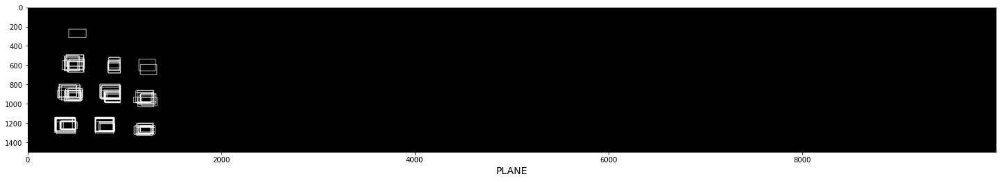

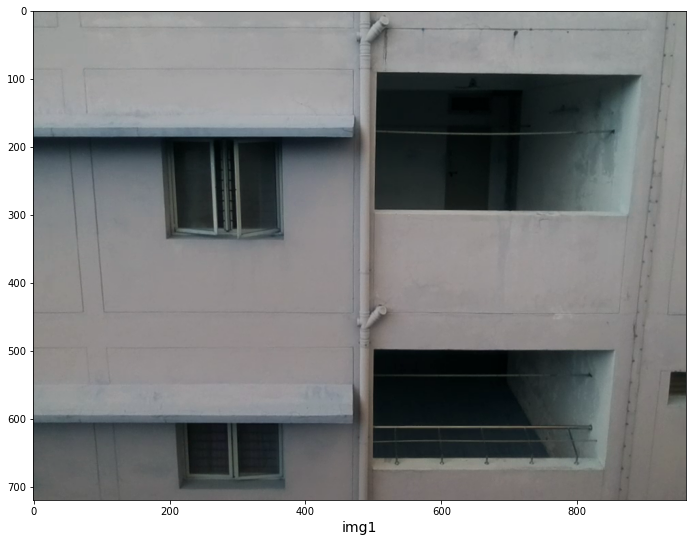

[[[215. 612.]
  [215. 697.]
  [362. 697.]
  [362. 612.]]

 [[192. 192.]
  [192. 332.]
  [360. 332.]
  [360. 192.]]]
(2, 4, 2)
[215, 612, 362, 697]
[192, 192, 360, 332]


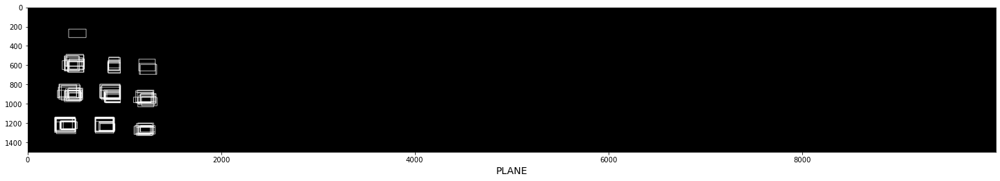

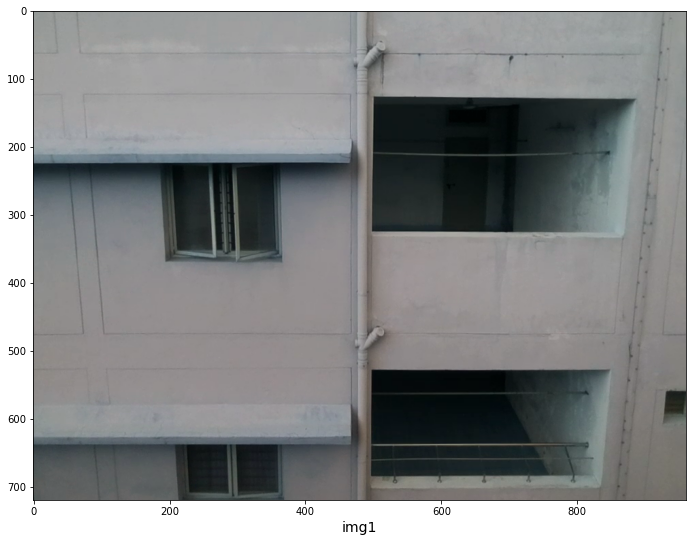

[[[215. 642.]
  [215. 720.]
  [362. 720.]
  [362. 642.]]

 [[190. 232.]
  [190. 362.]
  [357. 362.]
  [357. 232.]]]
(2, 4, 2)
[215, 642, 362, 719]
[190, 232, 357, 362]


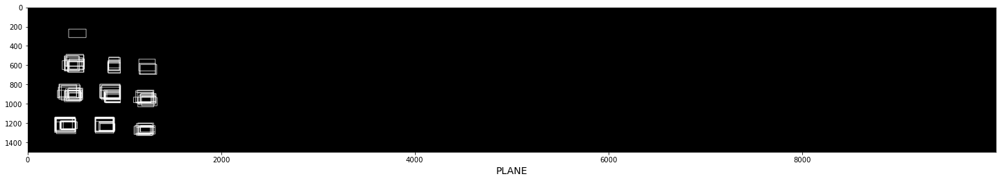

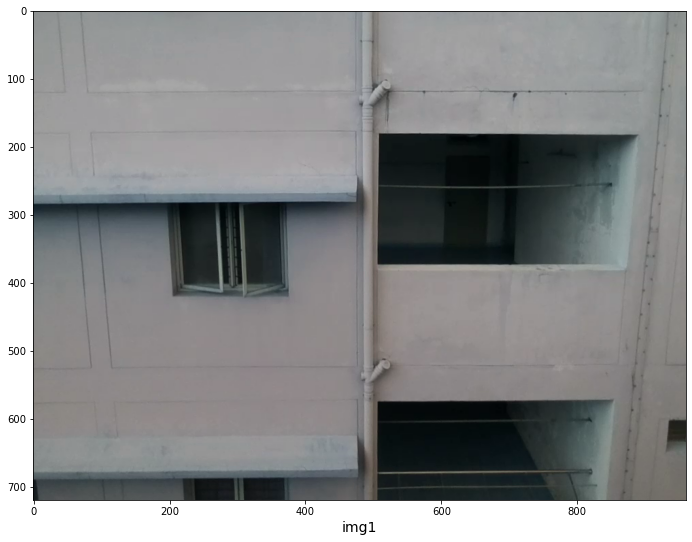

[[[202. 290.]
  [202. 412.]
  [367. 412.]
  [367. 290.]]]
(1, 4, 2)
[202, 290, 367, 412]


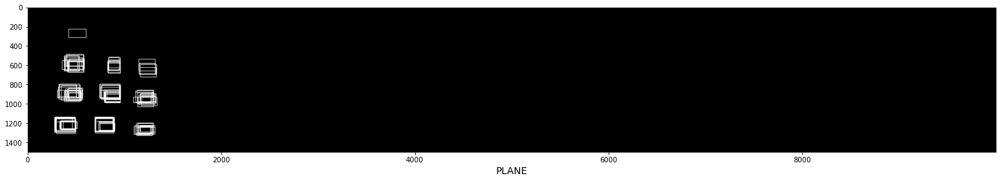

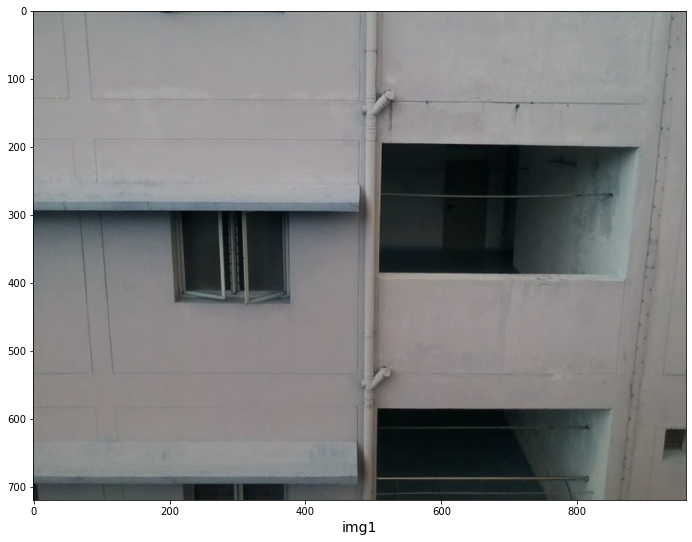

[[[207. 302.]
  [207. 425.]
  [370. 425.]
  [370. 302.]]]
(1, 4, 2)
[207, 302, 370, 425]


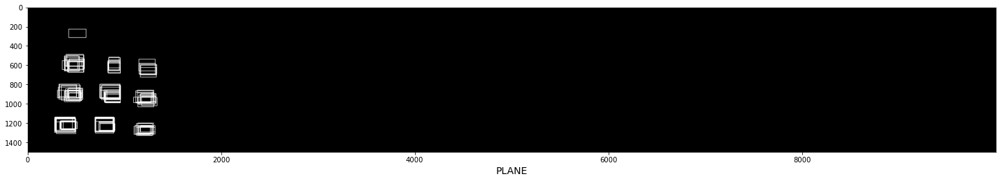

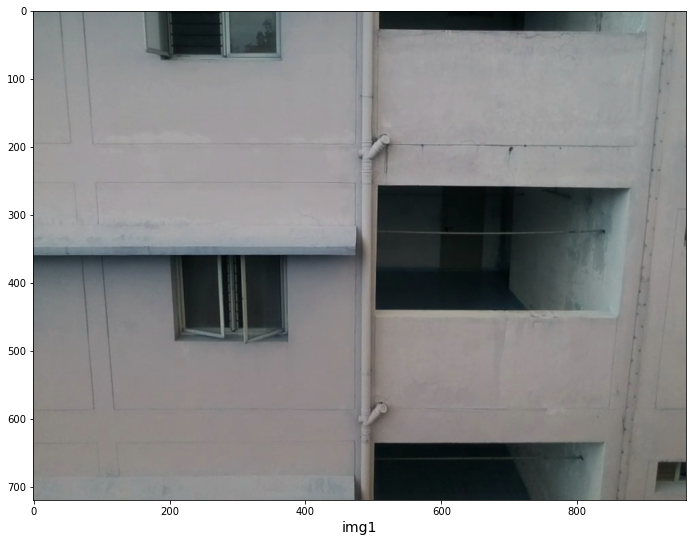

[[[207. 365.]
  [207. 482.]
  [367. 482.]
  [367. 365.]]]
(1, 4, 2)
[207, 365, 367, 482]


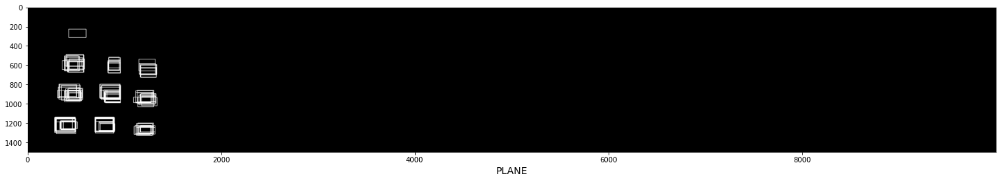

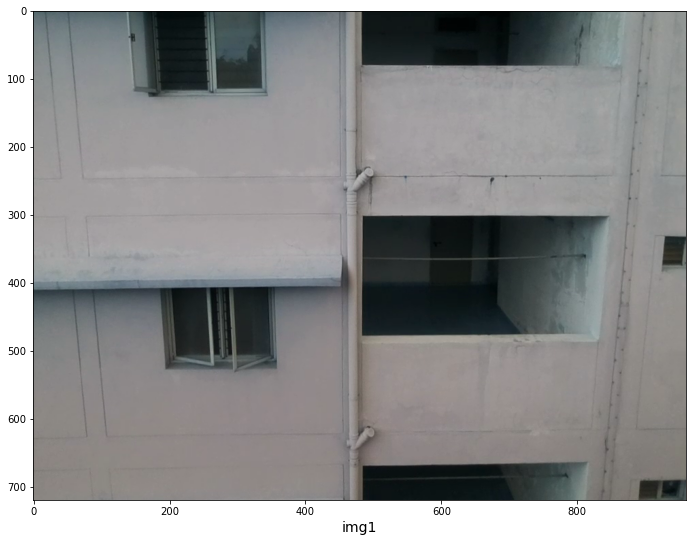

[[[190. 415.]
  [190. 520.]
  [352. 520.]
  [352. 415.]]

 [[155.   0.]
  [155. 122.]
  [340. 122.]
  [340.   0.]]]
(2, 4, 2)
[190, 415, 352, 520]
[155, 0, 340, 122]


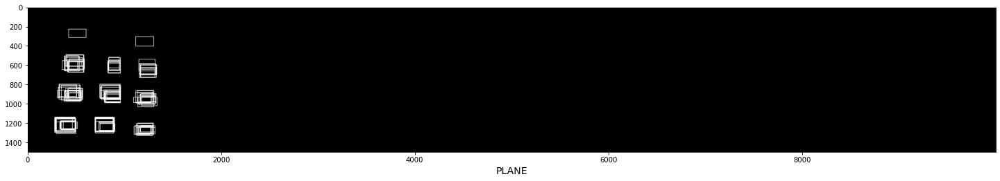

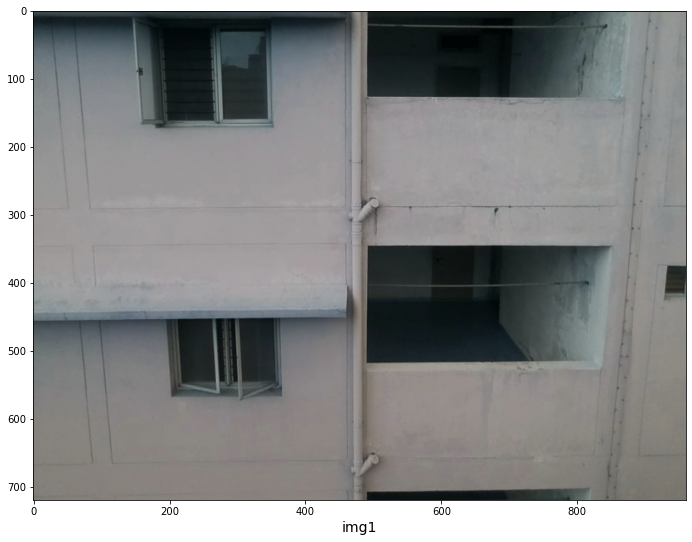

[[[200. 460.]
  [200. 562.]
  [360. 562.]
  [360. 460.]]

 [[162.  20.]
  [162. 167.]
  [347. 167.]
  [347.  20.]]]
(2, 4, 2)
[200, 460, 360, 562]
[162, 20, 347, 167]


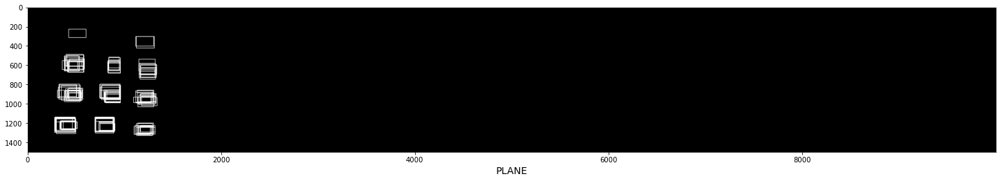

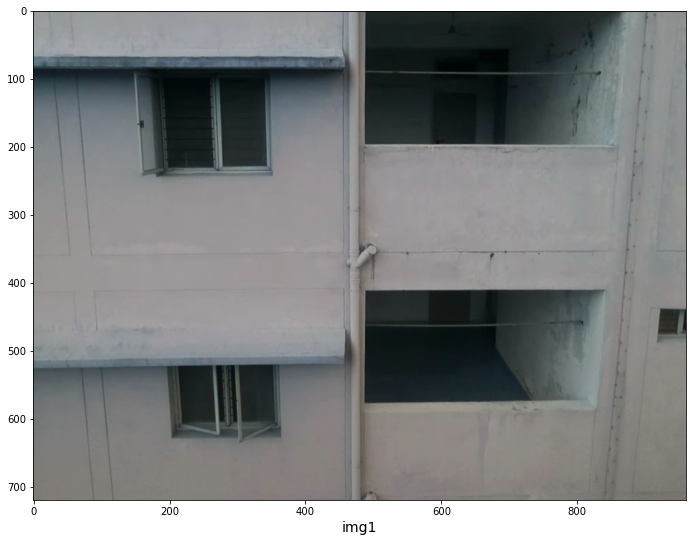

[[[200. 527.]
  [200. 625.]
  [357. 625.]
  [357. 527.]]

 [[160.  90.]
  [160. 237.]
  [345. 237.]
  [345.  90.]]]
(2, 4, 2)
[200, 527, 357, 625]
[160, 90, 345, 237]


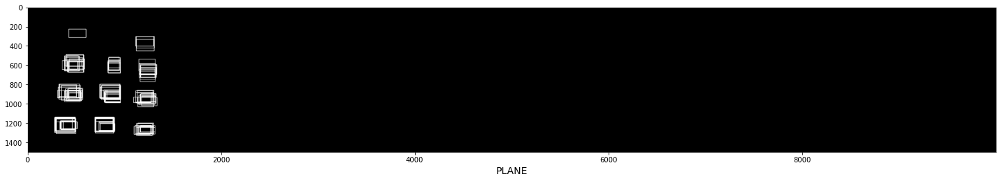

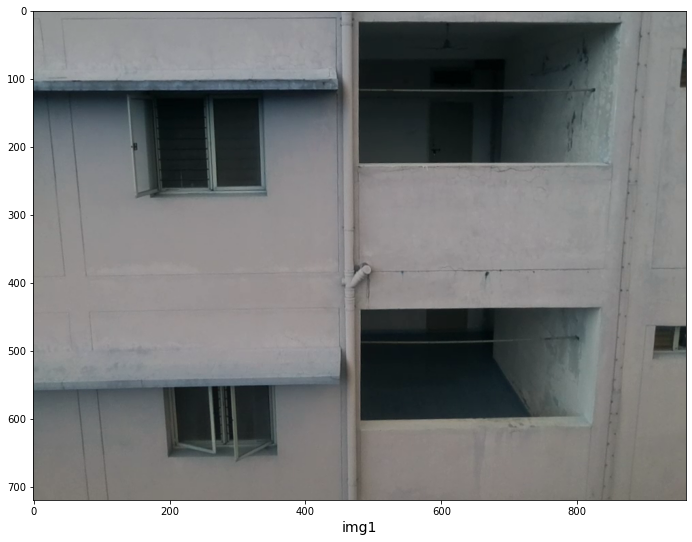

[[[190. 557.]
  [190. 650.]
  [352. 650.]
  [352. 557.]]

 [[157. 125.]
  [157. 270.]
  [335. 270.]
  [335. 125.]]]
(2, 4, 2)
[190, 557, 352, 650]
[157, 125, 335, 270]


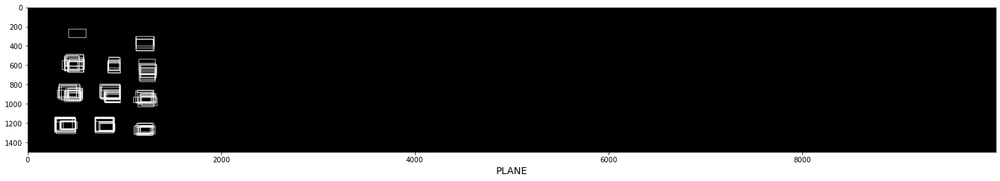

before NMS: [[1122 1246 1285 1329]
 [1137  931 1300 1033]
 [1160  692 1317  772]
 [1120  336 1305  455]]


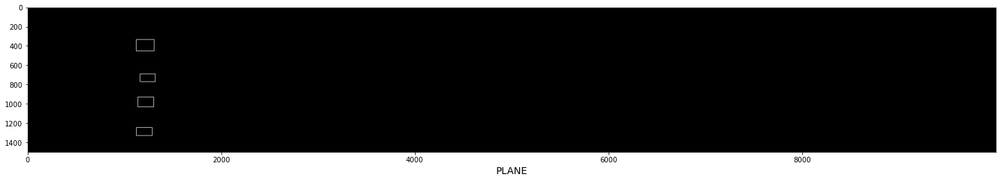

(4, 4)
after NMS: [[1122 1246 1285 1329]
 [1137  931 1300 1033]
 [1160  692 1317  772]
 [1120  336 1305  455]]
(4, 4)
finalBoxes [[1122 1246 1285 1329]
 [1137  931 1300 1033]
 [1160  692 1317  772]
 [1120  336 1305  455]]
finalBoxes shape (4, 4)


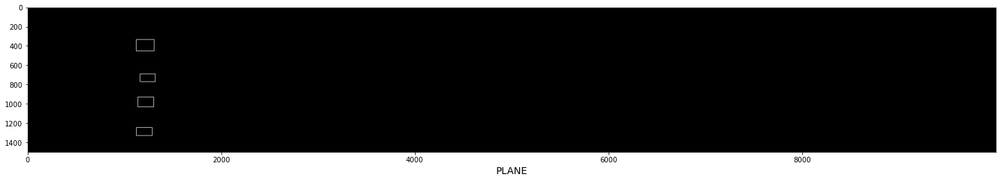

Total no. of windows in seq: 4
yAvg Heights: [ 212.5  518.   768.  1104.5]
avgStoreyHeights:  [212.5, 518.0, 768.0, 1104.5]
StoreyCount after running post processing module:  4
finallist 26
Total no. of windows in seq: 4
StoreyCount: 4
storeyHeights: [212.5, 518.0, 768.0, 1104.5]
FinalBoxes: [[1122 1246 1285 1329]
 [1137  931 1300 1033]
 [1160  692 1317  772]
 [1120  336 1305  455]]
FinalBoxes (in list): [array([1122, 1246, 1285, 1329]), array([1137,  931, 1300, 1033]), array([1160,  692, 1317,  772]), array([1120,  336, 1305,  455])]
Diff in storeyheights: [305.5 250.  336.5]
Diff in AvgStoreyHeights: [305.5 250.  336.5]
Offset Final: 41.5
final storey heights [ 171.   476.5  726.5 1063. ]
Height difference between 2 consecutive stories of a single vertical sequence [305.5 250.  336.5]


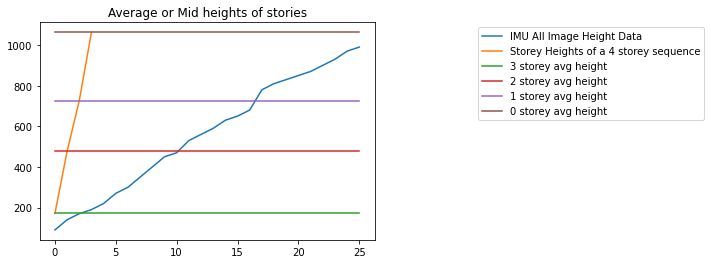

Final list size: 20
[120, 190, 240, 290, 340, 390, 530, 580, 640, 660, 700, 730, 770, 790, 830, 870, 920, 930, 960, 1000]
['bakul3_003_000120.png', 'bakul3_003_000190.png', 'bakul3_003_000240.png', 'bakul3_003_000290.png', 'bakul3_003_000340.png', 'bakul3_003_000390.png', 'bakul3_003_000530.png', 'bakul3_003_000580.png', 'bakul3_003_000630.png', 'bakul3_003_000660.png', 'bakul3_003_000690.png', 'bakul3_003_000730.png', 'bakul3_003_000770.png', 'bakul3_003_000800.png', 'bakul3_003_000830.png', 'bakul3_003_000870.png', 'bakul3_003_000920.png', 'bakul3_003_000930.png', 'bakul3_003_000960.png', 'bakul3_003_0001000.png']
pitch:  [0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, -1, 1]
roll:  [0, 1, 0, 0, 1, 0, 1, 0, 0, 2, 0, 0, 0, 0, 0, 1, 2, 1, 1, 2]
yaw:  [67, 67, 67, 67, 67, 67, 67, 67, 67, 67, 67, 67, 67, 67, 67, 67, 67, 67, 67, 67]
y_corrections for pitch:  [-0.0, -0.0, -13.09129869616319, -13.09129869616319, -13.09129869616319, -0.0, -13.09129869616319, -13.09129869616319, -13.09

<ipython-input-7-0e56a2c47fbf>:7: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  data = read_csv(seqLogFile, sep = " , ", header=None) #read imu data file


../sample_seq_data/003_new/images\bakul3_003_000240.png
../sample_seq_data/003_new/images\bakul3_003_000290.png
../sample_seq_data/003_new/images\bakul3_003_000340.png
../sample_seq_data/003_new/images\bakul3_003_000390.png
../sample_seq_data/003_new/images\bakul3_003_000530.png
../sample_seq_data/003_new/images\bakul3_003_000580.png
../sample_seq_data/003_new/images\bakul3_003_000630.png
../sample_seq_data/003_new/images\bakul3_003_000660.png
../sample_seq_data/003_new/images\bakul3_003_000690.png
../sample_seq_data/003_new/images\bakul3_003_000730.png
../sample_seq_data/003_new/images\bakul3_003_000770.png
../sample_seq_data/003_new/images\bakul3_003_000800.png
../sample_seq_data/003_new/images\bakul3_003_000830.png
../sample_seq_data/003_new/images\bakul3_003_000870.png
../sample_seq_data/003_new/images\bakul3_003_000920.png
../sample_seq_data/003_new/images\bakul3_003_000930.png
../sample_seq_data/003_new/images\bakul3_003_000960.png
../sample_seq_data/003_new/images\bakul3_003_000

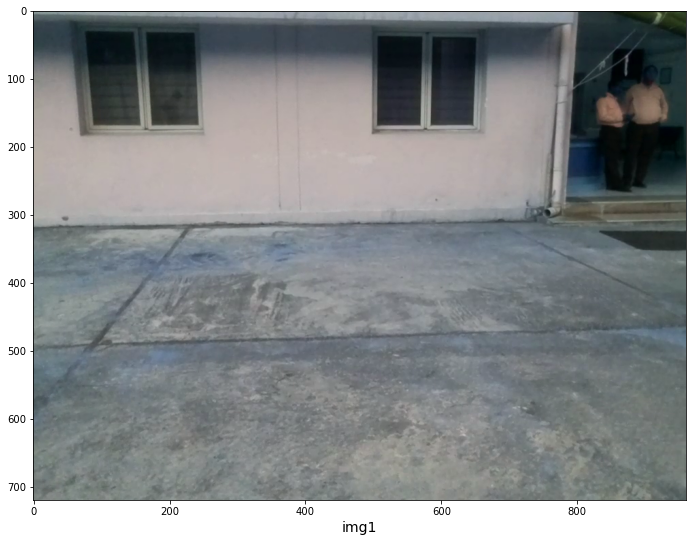

[[[464.  12.]
  [464. 200.]
  [677. 200.]
  [677.  12.]]

 [[ 66.  17.]
  [ 66. 192.]
  [261. 192.]
  [261.  17.]]]
(2, 4, 2)
[464, 12, 677, 200]
[66, 17, 261, 192]


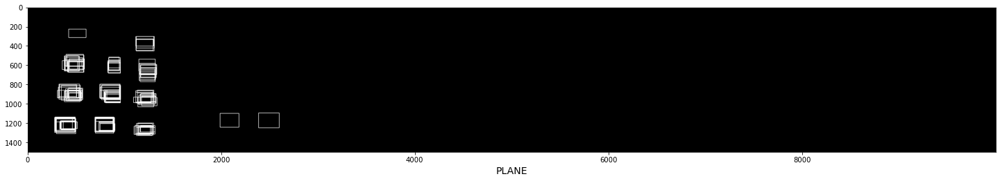

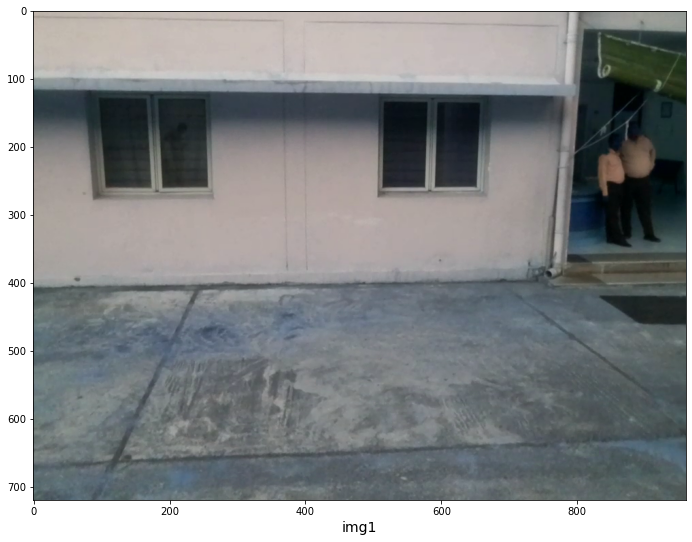

[[[480. 110.]
  [480. 290.]
  [682. 290.]
  [682. 110.]]

 [[ 88. 115.]
  [ 88. 285.]
  [278. 285.]
  [278. 115.]]]
(2, 4, 2)
[480, 110, 682, 290]
[88, 115, 278, 285]


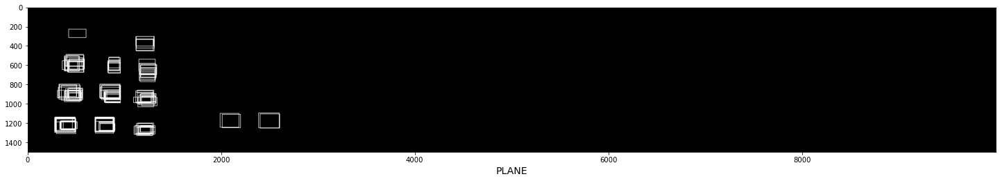

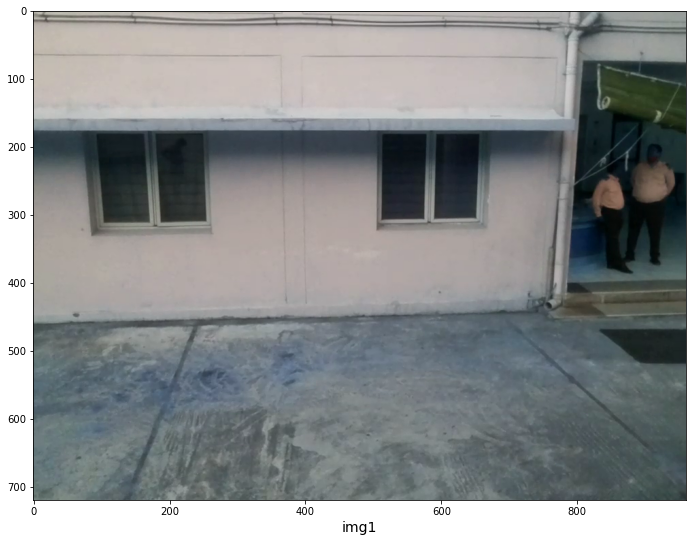

[[[479. 167.]
  [479. 337.]
  [679. 337.]
  [679. 167.]]

 [[ 81. 165.]
  [ 81. 332.]
  [268. 332.]
  [268. 165.]]]
(2, 4, 2)
[479, 167, 679, 337]
[81, 165, 268, 332]


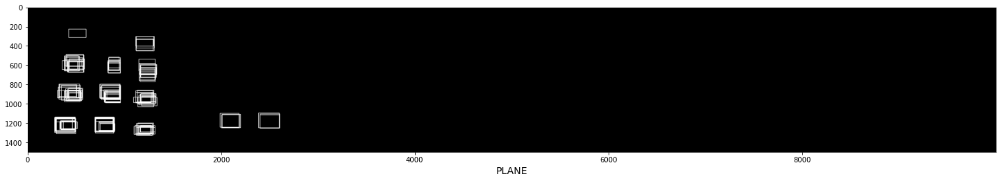

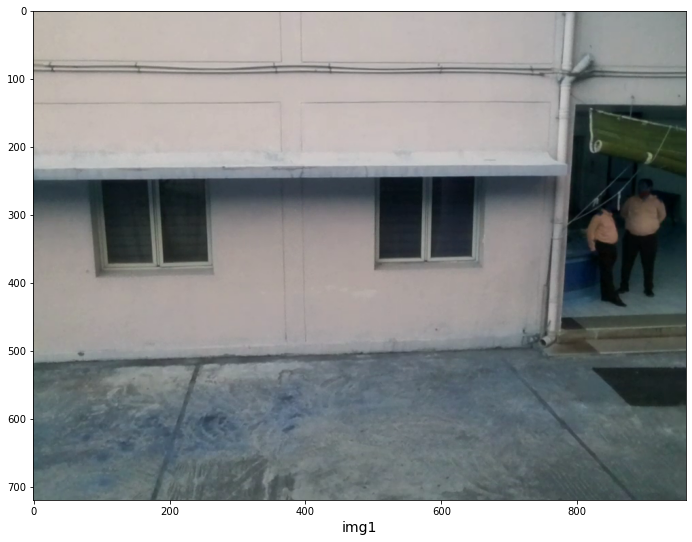

[[[472. 240.]
  [472. 400.]
  [672. 400.]
  [672. 240.]]

 [[ 87. 257.]
  [ 87. 380.]
  [257. 380.]
  [257. 257.]]]
(2, 4, 2)
[472, 240, 672, 400]
[87, 257, 257, 380]


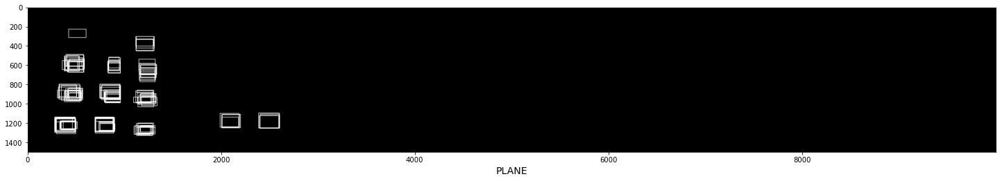

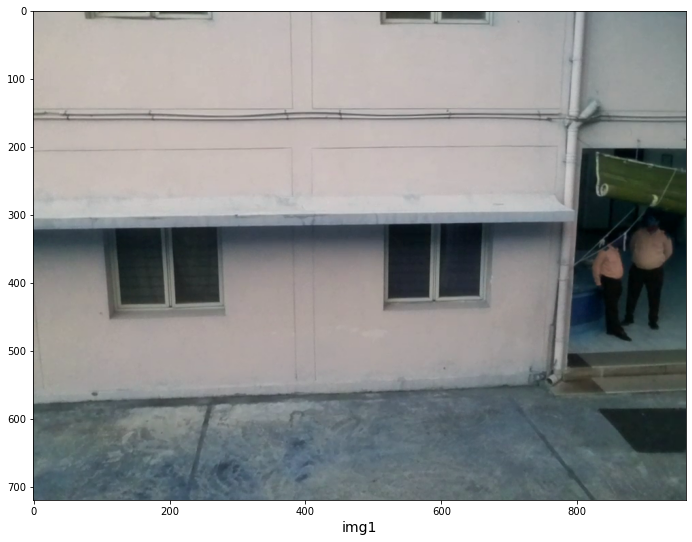

[[[485. 307.]
  [485. 460.]
  [683. 460.]
  [683. 307.]]

 [[107. 327.]
  [107. 440.]
  [275. 440.]
  [275. 327.]]]
(2, 4, 2)
[485, 307, 683, 460]
[107, 327, 275, 440]


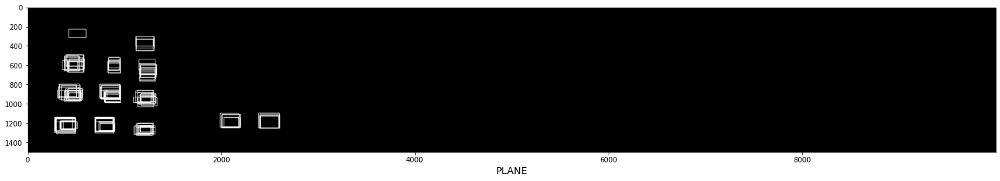

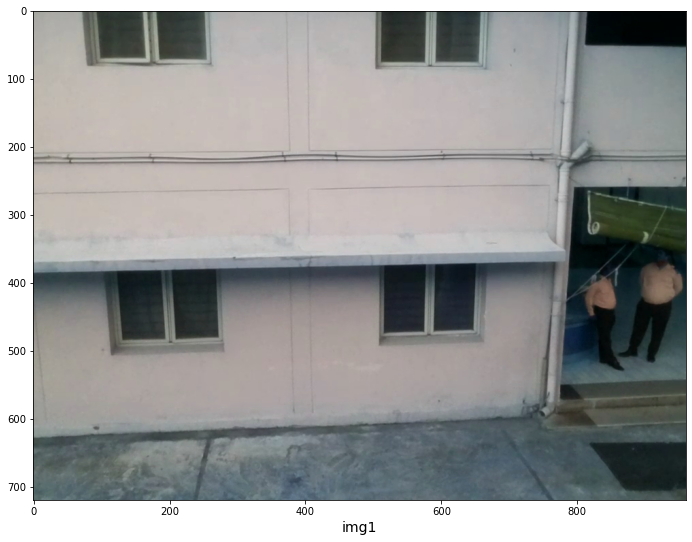

[[[112. 390.]
  [112. 490.]
  [275. 490.]
  [275. 390.]]

 [[510. 382.]
  [510. 480.]
  [655. 480.]
  [655. 382.]]

 [[ 75.   0.]
  [ 75. 100.]
  [265. 100.]
  [265.   0.]]

 [[472.   0.]
  [472.  97.]
  [687.  97.]
  [687.   0.]]]
(4, 4, 2)
[112, 390, 275, 490]
[510, 382, 655, 480]
[75, 0, 265, 100]
[472, 0, 687, 97]


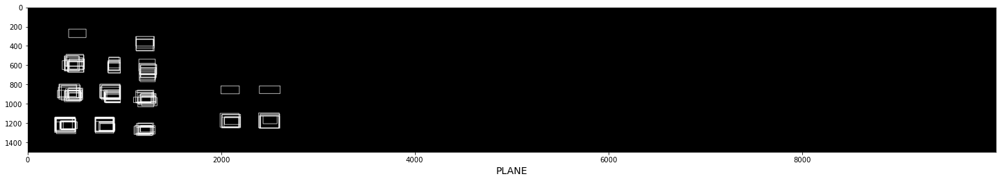

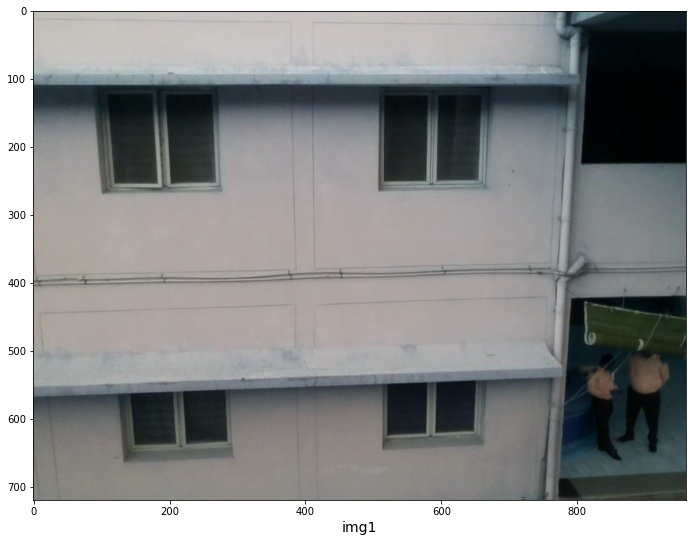

[[[132. 570.]
  [132. 650.]
  [287. 650.]
  [287. 570.]]

 [[515. 552.]
  [515. 632.]
  [655. 632.]
  [655. 552.]]

 [[481. 102.]
  [481. 285.]
  [686. 285.]
  [686. 102.]]

 [[ 93. 102.]
  [ 93. 277.]
  [286. 277.]
  [286. 102.]]]
(4, 4, 2)
[132, 570, 287, 650]
[515, 552, 655, 632]
[481, 102, 686, 285]
[93, 102, 286, 277]


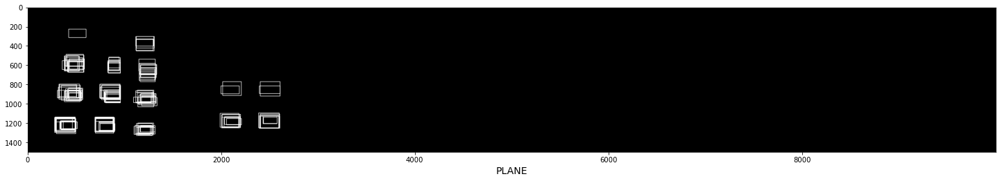

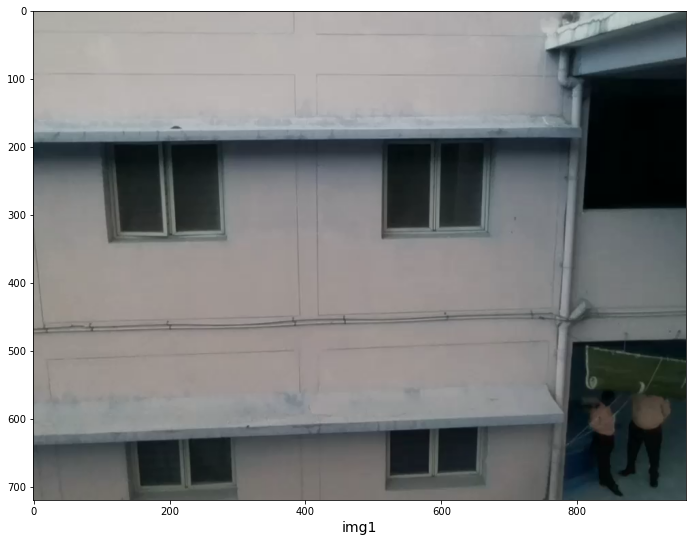

[[[142. 637.]
  [142. 710.]
  [295. 710.]
  [295. 637.]]

 [[517. 622.]
  [517. 690.]
  [657. 690.]
  [657. 622.]]

 [[482. 185.]
  [482. 352.]
  [687. 352.]
  [687. 185.]]

 [[105. 205.]
  [105. 332.]
  [280. 332.]
  [280. 205.]]]
(4, 4, 2)
[142, 637, 295, 710]
[517, 622, 657, 690]
[482, 185, 687, 352]
[105, 205, 280, 332]


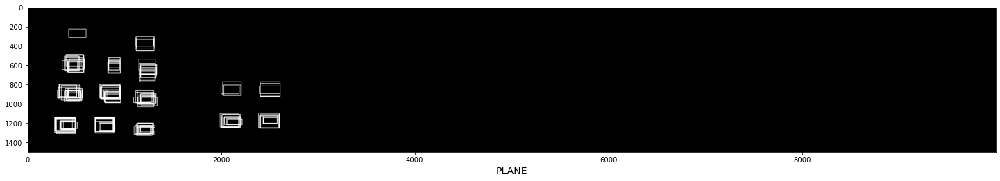

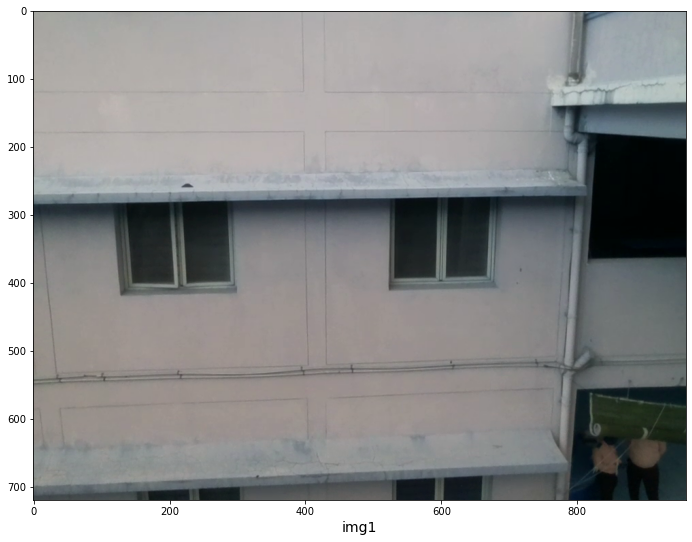

[[[122. 292.]
  [122. 407.]
  [292. 407.]
  [292. 292.]]

 [[527. 282.]
  [527. 402.]
  [672. 402.]
  [672. 282.]]]
(2, 4, 2)
[122, 292, 292, 407]
[527, 282, 672, 402]


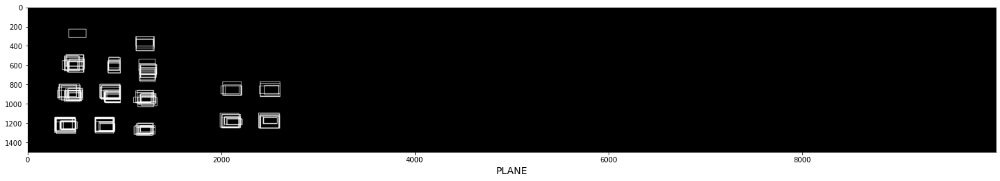

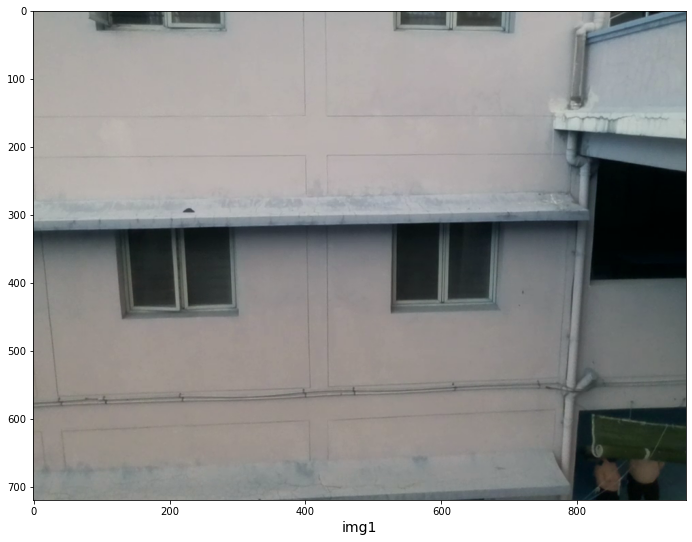

[[[495. 307.]
  [495. 465.]
  [698. 465.]
  [698. 307.]]

 [[122. 330.]
  [122. 440.]
  [295. 440.]
  [295. 330.]]]
(2, 4, 2)
[495, 307, 698, 465]
[122, 330, 295, 440]


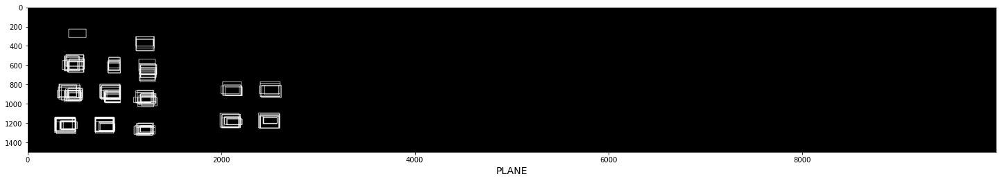

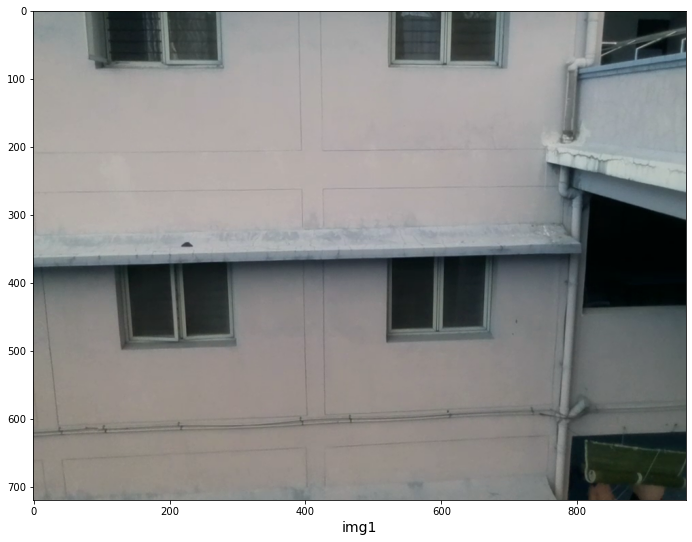

[[[122. 385.]
  [122. 487.]
  [295. 487.]
  [295. 385.]]

 [[525. 370.]
  [525. 477.]
  [667. 477.]
  [667. 370.]]

 [[483.   0.]
  [483. 100.]
  [708. 100.]
  [708.   0.]]

 [[ 92.   0.]
  [ 92.  97.]
  [295.  97.]
  [295.   0.]]]
(4, 4, 2)
[122, 385, 295, 487]
[525, 370, 667, 477]
[483, 0, 708, 100]
[92, 0, 295, 97]


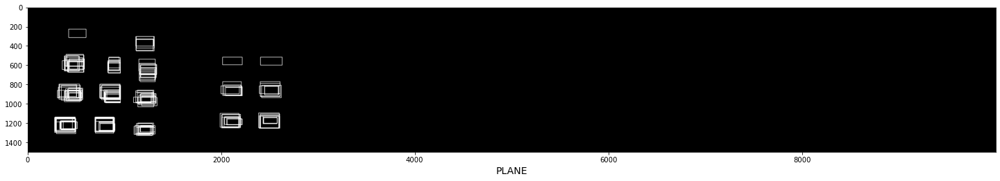

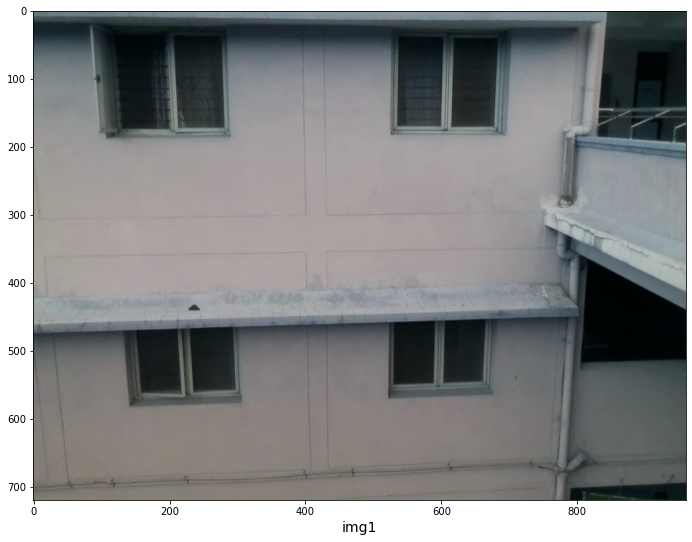

[[[135. 477.]
  [135. 572.]
  [302. 572.]
  [302. 477.]]

 [[525. 462.]
  [525. 560.]
  [670. 560.]
  [670. 462.]]

 [[488.  12.]
  [488. 202.]
  [710. 202.]
  [710.  12.]]

 [[ 95.  27.]
  [ 95. 180.]
  [287. 180.]
  [287.  27.]]]
(4, 4, 2)
[135, 477, 302, 572]
[525, 462, 670, 560]
[488, 12, 710, 202]
[95, 27, 287, 180]


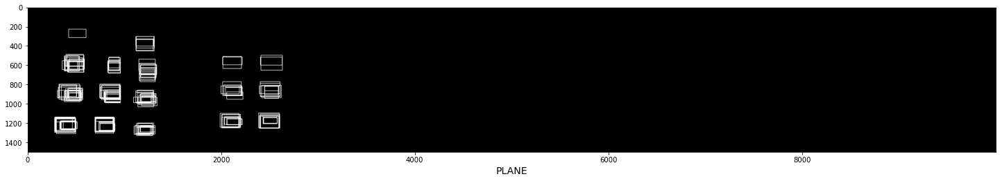

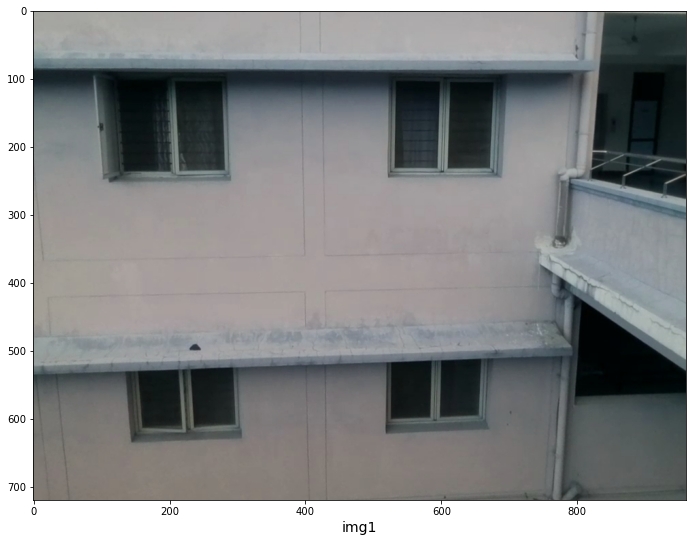

[[[140. 535.]
  [140. 625.]
  [302. 625.]
  [302. 535.]]

 [[520. 525.]
  [520. 610.]
  [665. 610.]
  [665. 525.]]

 [[482.  77.]
  [482. 265.]
  [700. 265.]
  [700.  77.]]

 [[ 97.  92.]
  [ 97. 245.]
  [285. 245.]
  [285.  92.]]]
(4, 4, 2)
[140, 535, 302, 625]
[520, 525, 665, 610]
[482, 77, 700, 265]
[97, 92, 285, 245]


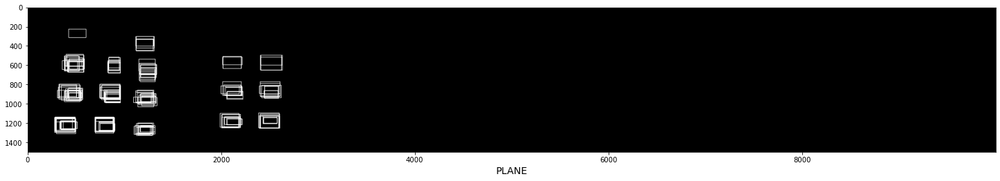

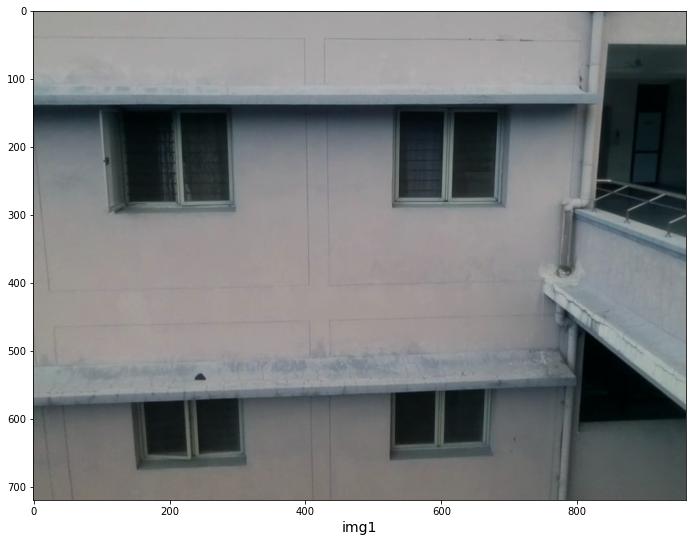

[[[145. 582.]
  [145. 662.]
  [307. 662.]
  [307. 582.]]

 [[525. 565.]
  [525. 650.]
  [667. 650.]
  [667. 565.]]

 [[496. 127.]
  [496. 310.]
  [708. 310.]
  [708. 127.]]

 [[118. 127.]
  [118. 300.]
  [308. 300.]
  [308. 127.]]]
(4, 4, 2)
[145, 582, 307, 662]
[525, 565, 667, 650]
[496, 127, 708, 310]
[118, 127, 308, 300]


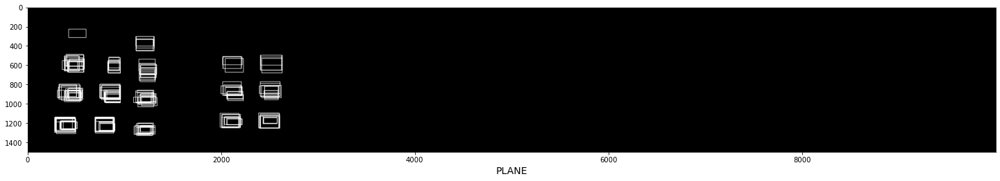

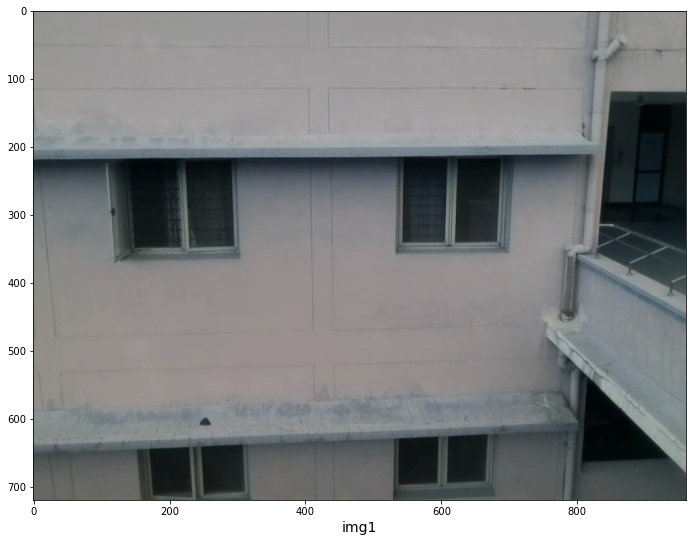

[[[530. 635.]
  [530. 707.]
  [672. 707.]
  [672. 635.]]

 [[115. 225.]
  [115. 357.]
  [297. 357.]
  [297. 225.]]

 [[537. 220.]
  [537. 352.]
  [692. 352.]
  [692. 220.]]]
(3, 4, 2)
[530, 635, 672, 707]
[115, 225, 297, 357]
[537, 220, 692, 352]


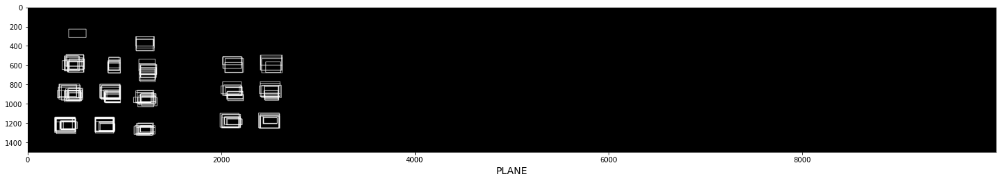

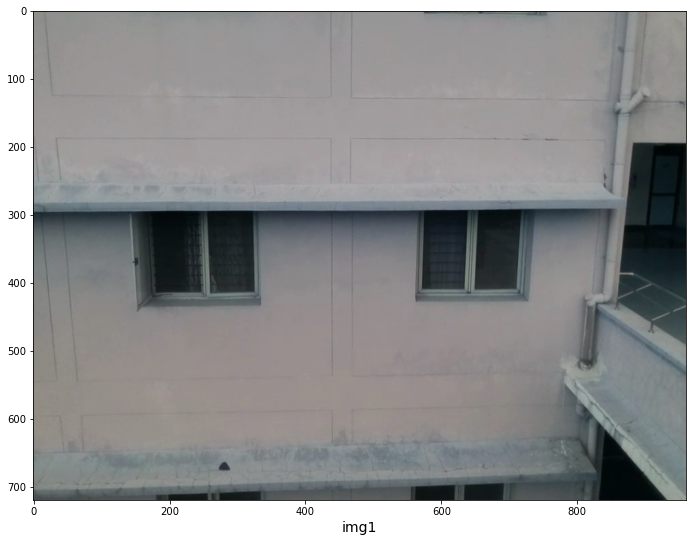

[[[529. 285.]
  [529. 447.]
  [739. 447.]
  [739. 285.]]

 [[157. 285.]
  [157. 437.]
  [349. 437.]
  [349. 285.]]]
(2, 4, 2)
[529, 285, 739, 447]
[157, 285, 349, 437]


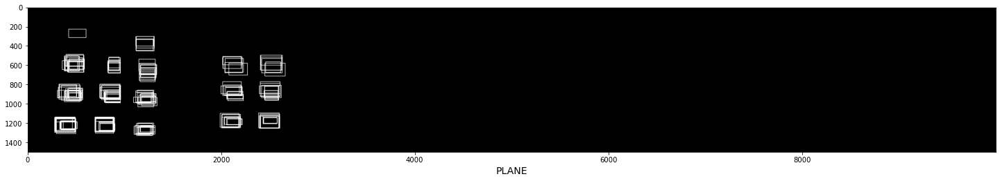

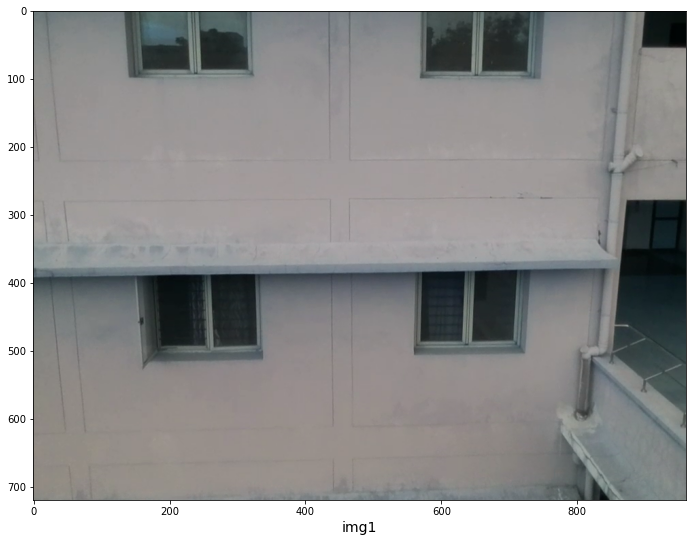

[[[157. 395.]
  [157. 502.]
  [332. 502.]
  [332. 395.]]

 [[565. 390.]
  [565. 500.]
  [717. 500.]
  [717. 390.]]

 [[135.   0.]
  [135. 115.]
  [340. 115.]
  [340.   0.]]

 [[544.   0.]
  [544. 112.]
  [757. 112.]
  [757.   0.]]]
(4, 4, 2)
[157, 395, 332, 502]
[565, 390, 717, 500]
[135, 0, 340, 115]
[544, 0, 757, 112]


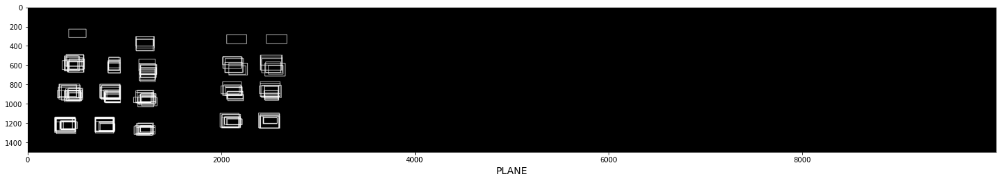

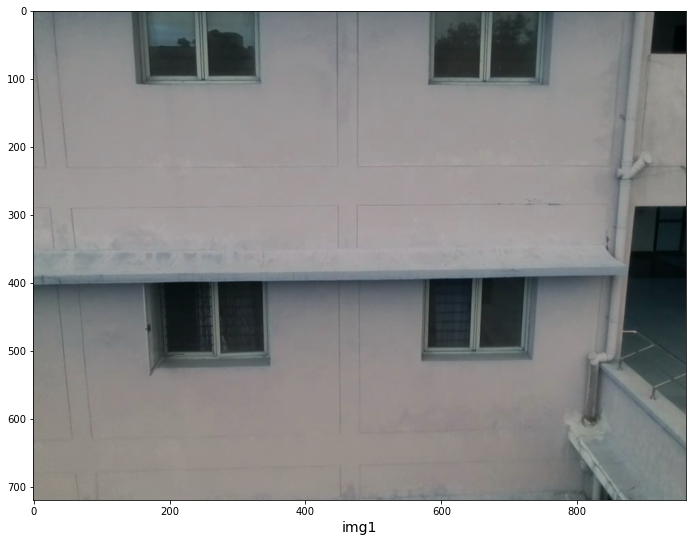

[[[170. 402.]
  [170. 515.]
  [345. 515.]
  [345. 402.]]

 [[575. 400.]
  [575. 510.]
  [727. 510.]
  [727. 400.]]

 [[148.   0.]
  [148. 127.]
  [350. 127.]
  [350.   0.]]

 [[555.   0.]
  [555. 125.]
  [768. 125.]
  [768.   0.]]]
(4, 4, 2)
[170, 402, 345, 515]
[575, 400, 727, 510]
[148, 0, 350, 127]
[555, 0, 768, 125]


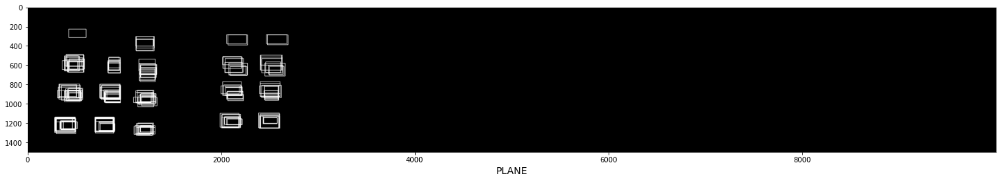

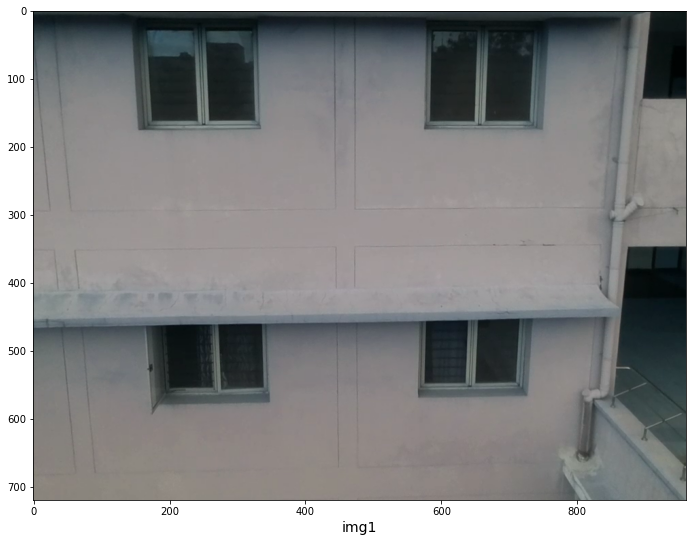

[[[170. 470.]
  [170. 567.]
  [345. 567.]
  [345. 470.]]

 [[570. 462.]
  [570. 562.]
  [720. 562.]
  [720. 462.]]

 [[546.   7.]
  [546. 190.]
  [756. 190.]
  [756.   7.]]

 [[150.  22.]
  [150. 170.]
  [330. 170.]
  [330.  22.]]]
(4, 4, 2)
[170, 470, 345, 567]
[570, 462, 720, 562]
[546, 7, 756, 190]
[150, 22, 330, 170]


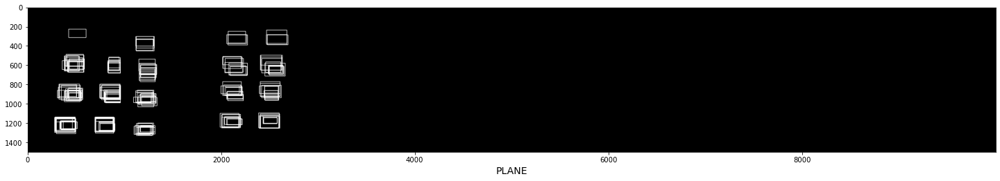

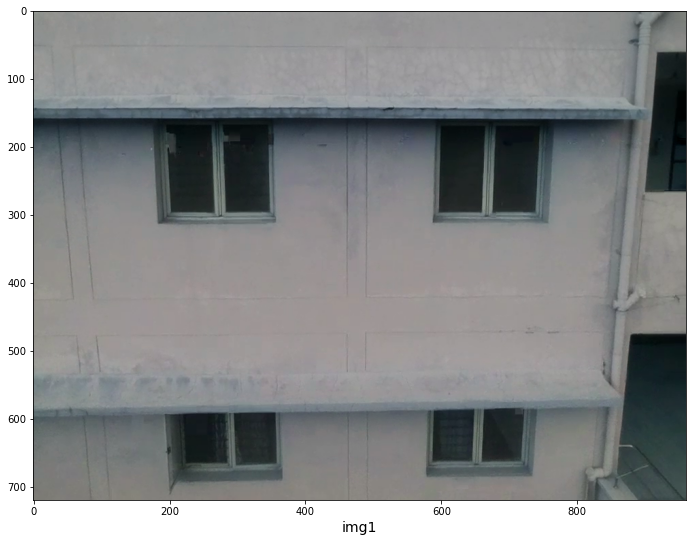

[[[200. 600.]
  [200. 682.]
  [360. 682.]
  [360. 600.]]

 [[580. 592.]
  [580. 677.]
  [727. 677.]
  [727. 592.]]

 [[562. 147.]
  [562. 327.]
  [764. 327.]
  [764. 147.]]

 [[178. 147.]
  [178. 325.]
  [375. 325.]
  [375. 147.]]]
(4, 4, 2)
[200, 600, 360, 682]
[580, 592, 727, 677]
[562, 147, 764, 327]
[178, 147, 375, 325]


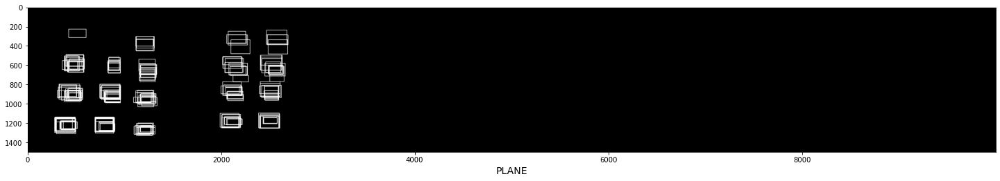

before NMS: [[2392 1125 2592 1255]
 [2001 1114 2188 1250]
 [2065  904 2227  969]
 [2450  907 2592  965]
 [2120  708 2280  775]
 [2500  702 2647  771]
 [2482  339 2684  486]
 [2098  339 2295  484]]


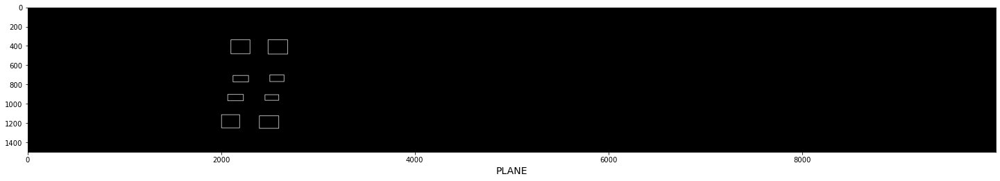

(8, 4)
after NMS: [[2392 1125 2592 1255]
 [2001 1114 2188 1250]
 [2065  904 2227  969]
 [2450  907 2592  965]
 [2120  708 2280  775]
 [2500  702 2647  771]
 [2482  339 2684  486]
 [2098  339 2295  484]]
(8, 4)
finalBoxes [[2392 1125 2592 1255]
 [2001 1114 2188 1250]
 [2065  904 2227  969]
 [2450  907 2592  965]
 [2120  708 2280  775]
 [2500  702 2647  771]
 [2482  339 2684  486]
 [2098  339 2295  484]]
finalBoxes shape (8, 4)


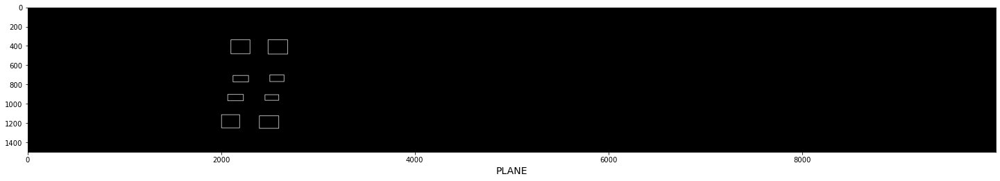

Total no. of windows in seq: 8
yAvg Heights: [ 310.   318.   563.5  564.   758.5  763.5 1087.5 1088.5]
avgStoreyHeights:  [314.0, 563.75, 761.0, 1088.0]
StoreyCount after running post processing module:  4
finallist 20
Total no. of windows in seq: 8
StoreyCount: 4
storeyHeights: [310.0, 563.5, 758.5, 1087.5]
FinalBoxes: [[2392 1125 2592 1255]
 [2001 1114 2188 1250]
 [2065  904 2227  969]
 [2450  907 2592  965]
 [2120  708 2280  775]
 [2500  702 2647  771]
 [2482  339 2684  486]
 [2098  339 2295  484]]
FinalBoxes (in list): [array([2392, 1125, 2592, 1255]), array([2001, 1114, 2188, 1250]), array([2065,  904, 2227,  969]), array([2450,  907, 2592,  965]), array([2120,  708, 2280,  775]), array([2500,  702, 2647,  771]), array([2482,  339, 2684,  486]), array([2098,  339, 2295,  484])]
Diff in storeyheights: [253.5 195.  329. ]
Diff in AvgStoreyHeights: [249.75 197.25 327.  ]
Offset Final: 194.0
final storey heights [120.   369.75 567.   894.  ]
Height difference between 2 consecutive sto

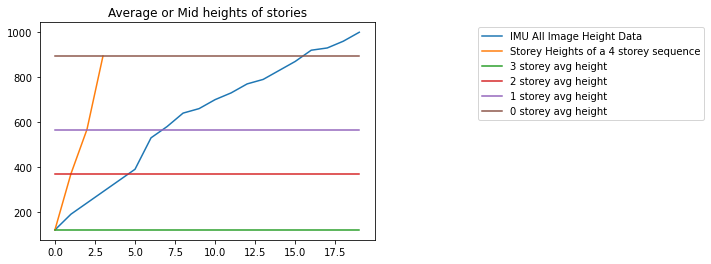

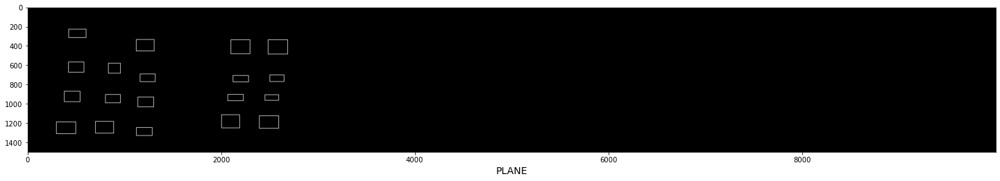

Total window count in Bakul: 19


In [23]:
final_building_boxes = np.array([])

seq_num = 1
final_building_boxes, windowCount1, storeyCount1, avgStoreyHeights1 = runVerticalMap(final_building_boxes, verticalPlane, imgPath, coordFilePath, offset_ramp_001, seq_num)
seq_num = 2
final_building_boxes, windowCount2, storeyCount2, avgStoreyHeights2 = runVerticalMap(final_building_boxes, verticalPlane, imgPath2, coordFilePath2, offset_ramp_002, seq_num)
seq_num = 3
final_building_boxes, windowCount3, storeyCount3, avgStoreyHeights3 = runVerticalMap(final_building_boxes, verticalPlane, imgPath3, coordFilePath3, offset_ramp_003, seq_num)

plotBoxes(np.copy(verticalPlane), final_building_boxes)

print('Total window count in Bakul:', str(windowCount1 + windowCount2 + windowCount3))